In [26]:
import numpy as np
from numpy.fft import fftshift, fftfreq, fft
import matplotlib.pyplot as plt
import pandas as pd
import sys
sys.path.append("..")
from utils import *
from utils import Shuffler

In [3]:
df = pd.read_csv("../simulation/data/debug/excitation_sinusoidal.csv")

In [4]:
df

,Unnamed: 0,t,x,y,fx,fy,freq,axis,seal,episode
0,0,0.0000,0.000000e+00,0.000000e+00,0.000000,0.000000,4,x,True,0
1,1,0.0001,4.182320e-12,-8.983704e-19,0.002513,0.000000,4,x,True,0
2,2,0.0002,3.339201e-11,-7.739025e-16,0.005027,0.000000,4,x,True,0
3,3,0.0003,1.125290e-10,-2.350727e-15,0.007540,0.000000,4,x,True,0
4,4,0.0004,2.663489e-10,-4.205185e-15,0.010053,0.000000,4,x,True,0
...,...,...,...,...,...,...,...,...,...,...
5599995,99995,9.9995,0.000000e+00,8.610058e-07,-0.000000,-0.215076,69,y,False,0
5599996,99996,9.9996,0.000000e+00,6.239603e-07,-0.000000,-0.172548,69,y,False,0
5599997,99997,9.9997,0.000000e+00,3.857281e-07,-0.000000,-0.129696,69,y,False,0
5599998,99998,9.9998,0.000000e+00,1.468552e-07,-0.000000,-0.086599,69,y,False,0


In [5]:
freq = 69
sel_df = df[(df.seal == False) & (df.axis == "x") & (df.episode == 0) & (df.freq == freq)]

(2.0, 3.0)

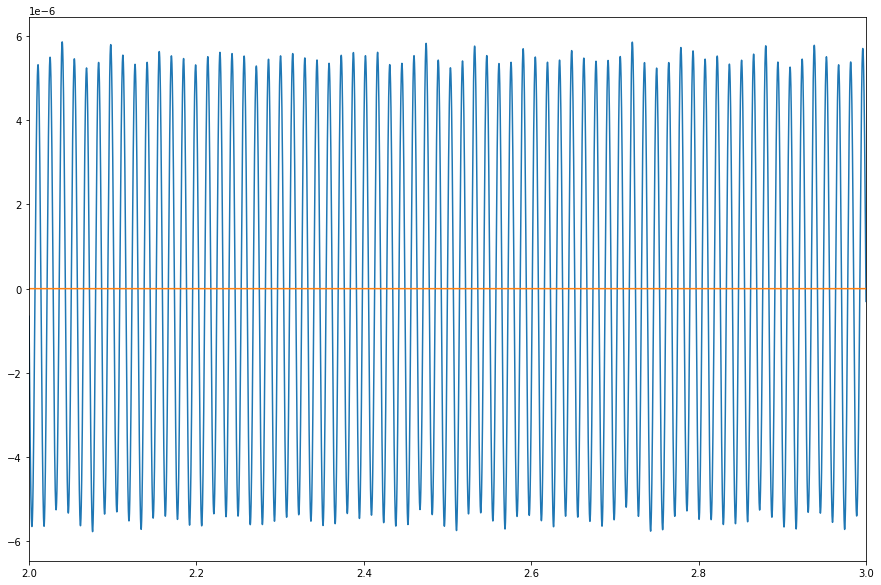

In [6]:
plt.figure(figsize=(15,10))
plt.plot(sel_df.t[sel_df.t > 2], sel_df.x[sel_df.t > 2])
plt.plot(sel_df.t[sel_df.t > 2], sel_df.y[sel_df.t > 2])
plt.xlim(2, 3)

# Linear Regression

In [7]:
def linreg_estimate(df):
    
    #df["x_dot2"] =  df["x_dot2"].shift()
    #df["y_dot2"] =  df["y_dot2"].shift()
    
    df = df[df.t > 0.5]
    X = df[["x_dot", "y_dot", "x", "y"]].values
    df["fx_"] = df["fx"] - 1*df["x_dot2"]
    df["fy_"] = df["fy"] - 1*df["y_dot2"]
    Y = df[["fx_", "fy_"]].values
    params = np.linalg.inv( X.transpose() @ X ) @ X.transpose() @ Y
    
    C = params[:2].transpose()
    K = params[2:].transpose()
    
    return {"C" : C,
            "K" : K}

def add_derivatives(df):
    all_data = pd.DataFrame()
    
    for name, group in df.groupby(["seal", "episode", "freq"]):
        
        dt = (df["t"] - df["t"].shift()).median()
        group = append_derivatives_to_dataframe(group, "x", dt=dt)
        group = append_derivatives_to_dataframe(group, "y", dt=dt)
        
        all_data = pd.concat([all_data, group])
        
    return all_data
        
    

In [8]:
freq = 19
sel_df = df[(df.seal == True) & (df.episode == 0) & (df.freq == freq)]
sel_df = add_derivatives(sel_df)
with_seal = linreg_estimate(sel_df)

<ipython-input-7-17b91547f282>:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df["fx_"] = df["fx"] - 1*df["x_dot2"]
<ipython-input-7-17b91547f282>:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df["fy_"] = df["fy"] - 1*df["y_dot2"]


In [9]:
sel_df = df[(df.seal == False) & (df.episode == 0) & (df.freq == freq)]
sel_df = add_derivatives(sel_df)
wo_seal = linreg_estimate(sel_df)

<ipython-input-7-17b91547f282>:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df["fx_"] = df["fx"] - 1*df["x_dot2"]
<ipython-input-7-17b91547f282>:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df["fy_"] = df["fy"] - 1*df["y_dot2"]


In [10]:
print("Seal C:", with_seal["C"] - wo_seal["C"])
print("Seal K:", with_seal["K"] - wo_seal["K"])

Seal C: [[ 4.11159038e+01 -3.63903490e-02]
 [-6.66335582e-02  4.31099948e+01]]
Seal K: [[4389.76593161 -402.78923367]
 [ 435.16027602  419.67416159]]


In [11]:
Cs = []
Ks = []
Fs = []

for freq in df.freq.unique():
    
    sel_df = df[(df.seal == True) &  (df.freq == freq)]
    sel_df = add_derivatives(sel_df)
    with_seal = linreg_estimate(sel_df)
    
    sel_df = df[(df.seal == False) &  (df.freq == freq)]
    sel_df = add_derivatives(sel_df)
    wo_seal = linreg_estimate(sel_df)

    C = with_seal["C"] - wo_seal["C"]
    K = with_seal["K"] - wo_seal["K"]
    
    Cs.append(C)
    Ks.append(K)
    Fs.append(freq)
    
Cs = np.array(Cs)
Ks = np.array(Ks)
Fs = np.array(Fs)

<ipython-input-7-17b91547f282>:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df["fx_"] = df["fx"] - 1*df["x_dot2"]
<ipython-input-7-17b91547f282>:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df["fy_"] = df["fy"] - 1*df["y_dot2"]
<ipython-input-7-17b91547f282>:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide

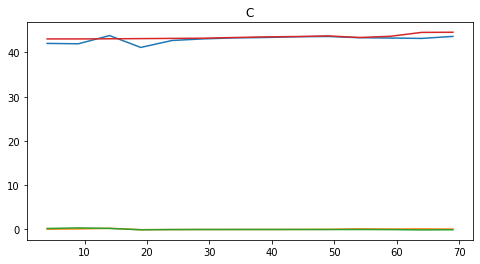

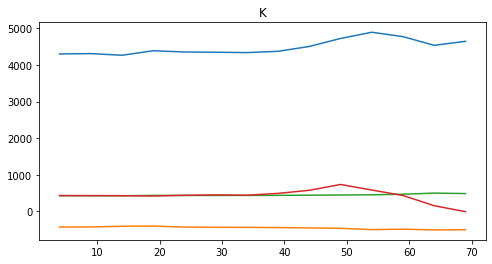

In [12]:
plt.figure(figsize=(8,4))
plt.title("C")
plt.plot(Fs, Cs[:, 0, 0])
plt.plot(Fs, Cs[:, 0, 1])
plt.plot(Fs, Cs[:, 1, 0])
plt.plot(Fs, Cs[:, 1, 1])
plt.show()


plt.figure(figsize=(8,4))
plt.title("K")
plt.plot(Fs, Ks[:, 0, 0])
plt.plot(Fs, Ks[:, 0, 1])
plt.plot(Fs, Ks[:, 1, 0])
plt.plot(Fs, Ks[:, 1, 1])
plt.show()

# EIV Estimator

In [13]:
def to_frequency_domain(df):
    data={}
    
    dt = (df["t"] - df["t"].shift()).median()
    for col in ["x", "y", "fy", "fx"]:
        data[col + "f"] = fftshift(fft(df[col].values))
    data["freqs"] = fftshift(fftfreq(data["xf"].shape[0], d = dt))
    return pd.DataFrame(data)

def eiv_estimate(df, freq):
    
    df_freq = pd.DataFrame()
    
    for (episode, axis), group in df.groupby(["episode", "axis"]):
        _df = to_frequency_domain(group)
        _df["axis"] = axis
        _df["episode"] = episode
        
        df_freq = pd.concat([df_freq, _df])
        
    df_freq = select_frequency(df_freq, freq=freq)
    
    Us = []
    Ys = []
    for episode, group in df_freq.groupby("episode"):
        U = group[["xf", "yf"]].values.transpose()
        Y = group[["fxf", "fyf"]].values.transpose()
        Us.append(U)
        Ys.append(Y)
        
    Us = np.array(Us)
    Ys = np.array(Ys)
    
    G = np.mean(Ys, axis=0) @ np.linalg.inv(np.mean(Us, axis=0))
    C = np.imag(G) / (2 * np.pi * freq)
    K = np.real(G) + (2 * np.pi * freq) ** 2 * np.array([[1, 0], [0, 1]])

    return {"freq": freq,
            "G": G,
            "C": C,
            "K": K}
    return df_freq

def select_frequency(df, freq, tol=1e-2):
    
    return df[np.abs(df.freqs - freq) <= tol]


In [14]:
freq = 19
sel_df = df[(df.seal == True) & (df.freq == freq)]
with_seal = eiv_estimate(sel_df, freq)

In [15]:
sel_df = df[(df.seal == False) & (df.freq == freq)]
wo_seal = eiv_estimate(sel_df, freq)

In [16]:
print("Seal C",with_seal["C"] - wo_seal["C"])
print("Seal K", with_seal["K"] - wo_seal["K"])

Seal C [[ 4.31309214e+01 -4.16376767e-03]
 [-1.94106815e-03  4.31539045e+01]]
Seal K [[4307.78618542 -432.46533684]
 [ 431.82049547  425.42568115]]


In [17]:
Cs = []
Ks = []
Fs = []

for freq in df.freq.unique():
    
    sel_df = df[(df.seal == True) &  (df.freq == freq)]
    with_seal = eiv_estimate(sel_df, freq)
    
    sel_df = df[(df.seal == False) &  (df.freq == freq)]
    wo_seal = eiv_estimate(sel_df, freq)

    C = with_seal["C"] - wo_seal["C"]
    K = with_seal["K"] - wo_seal["K"]
    
    Cs.append(C)
    Ks.append(K)
    Fs.append(freq)
    
Cs = np.array(Cs)
Ks = np.array(Ks)
Fs = np.array(Fs)

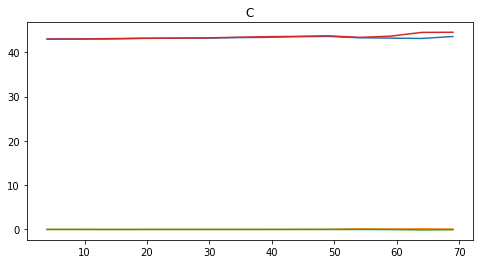

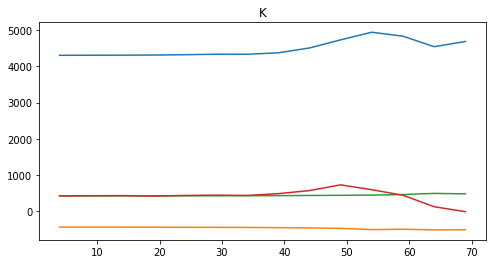

In [18]:
plt.figure(figsize=(8,4))
plt.title("C")
plt.plot(Fs, Cs[:, 0, 0])
plt.plot(Fs, Cs[:, 0, 1])
plt.plot(Fs, Cs[:, 1, 0])
plt.plot(Fs, Cs[:, 1, 1])
plt.show()


plt.figure(figsize=(8,4))
plt.title("K")
plt.plot(Fs, Ks[:, 0, 0])
plt.plot(Fs, Ks[:, 0, 1])
plt.plot(Fs, Ks[:, 1, 0])
plt.plot(Fs, Ks[:, 1, 1])
plt.show()

# Optimization

In [19]:
import jax
from jax import numpy as jnp
from jax.experimental.ode import odeint
from jax import grad, jit, vmap, value_and_grad, jacfwd, jacrev, jacobian, hessian
from jax import random
from jax.experimental import stax
from jax.experimental.optimizers import adam, sgd
from models.newton import mse, initialize_params, get_batch_forward_pass, get_loss_function, train

In [21]:
rng = random.PRNGKey(15)
params = initialize_params(rng, dims=2)

In [53]:


        
def optimize(q, q_dot, q_dot2, f, batch_size=128, step_size=1e2, epochs=15):

    rng = random.PRNGKey(15)
    params = initialize_params(rng, dims=2, scale=1)
    batch_forward_pass = get_batch_forward_pass(mass=[[1, 0],[0, 1]], g=jnp.array([[0],[0]]))
    
    
    shuffler = Shuffler(len(q))
    q_shuffled = shuffler.shuffle(q)
    q_dot_shuffled = shuffler.shuffle(q_dot)
    q_dot2_shuffled = shuffler.shuffle(q_dot2)
    f_shuffled = shuffler.shuffle(f)
    
    def callback(y_pred, y_true, window = 14000):
        
        plt.figure(figsize=(10, 8))
        random_ind = int(np.random.uniform(0, len(y_pred) - window - 1))
        plt.plot(shuffler.undo_shuffle(np.squeeze(y_pred))[random_ind:(random_ind + window)], linestyle="dotted")
        plt.plot(shuffler.undo_shuffle(np.squeeze(y_true))[random_ind:(random_ind + window)])
        plt.show()
    
    params=train(params, q_shuffled, q_dot_shuffled, q_dot2_shuffled, f_shuffled, batch_size=batch_size, optimizer=adam, step_size=step_size, epochs=epochs, callback=callback, batch_forward_pass=batch_forward_pass)
    return params



def optimization_estimate(df):
    q = df[["x", "y"]].values.reshape((-1, 2, 1))
    q_dot = df[["x_dot", "y_dot"]].values.reshape((-1, 2, 1))
    q_dot2 = df[["x_dot2", "y_dot2"]].values.reshape((-1, 2, 1))
    f = df[["fx", "fy"]].values.reshape((-1, 2, 1))
    params = optimize(q, q_dot, q_dot2, f, step_size=1e2, epochs=4)
    K, C = params
    return {"K" : K,
            "C" : C}
    

In [54]:
df_ = add_derivatives(df)

  0%|          | 1/1562 [00:00<04:29,  5.79it/s]

Epoch 0


100%|██████████| 1562/1562 [00:10<00:00, 148.76it/s]


Epoch 0 , mean error: 0.005642847 params: [DeviceArray([[11801.271  ,  -429.72705],
             [  433.3778 ,  7932.063  ]], dtype=float32), DeviceArray([[ 6.1990311e+01,  2.2647131e-02],
             [-4.9202487e-02,  6.1641254e+01]], dtype=float32)]


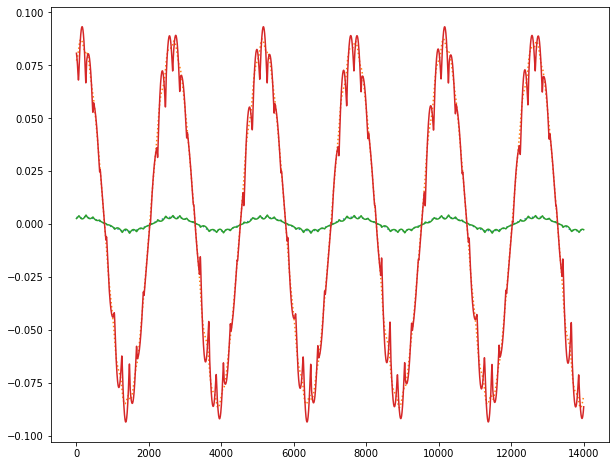

  1%|          | 17/1562 [00:00<00:09, 163.82it/s]

Epoch 1


100%|██████████| 1562/1562 [00:09<00:00, 166.56it/s]


Epoch 1 , mean error: 0.0017513322 params: [DeviceArray([[11802.218  ,  -430.50046],
             [  432.3379 ,  7931.9795 ]], dtype=float32), DeviceArray([[ 6.2229881e+01,  2.3544380e-01],
             [-5.2133352e-02,  6.2021854e+01]], dtype=float32)]


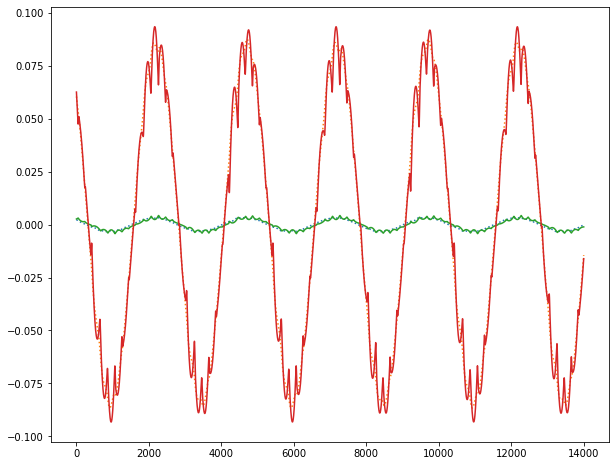

  1%|          | 17/1562 [00:00<00:09, 168.45it/s]

Epoch 2


100%|██████████| 1562/1562 [00:09<00:00, 156.32it/s]


Epoch 2 , mean error: 0.0017487189 params: [DeviceArray([[11801.093  ,  -430.79895],
             [  431.4344 ,  7932.982  ]], dtype=float32), DeviceArray([[62.29067   ,  0.29158613],
             [-0.09921935, 60.85164   ]], dtype=float32)]


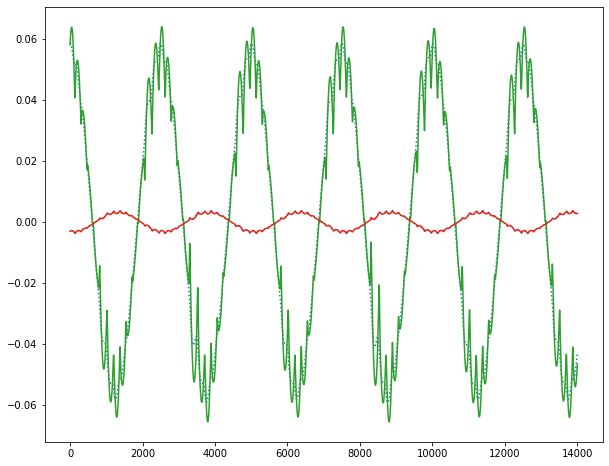

  1%|          | 15/1562 [00:00<00:10, 148.42it/s]

Epoch 3


100%|██████████| 1562/1562 [00:09<00:00, 158.17it/s]


Epoch 3 , mean error: 0.0017489569 params: [DeviceArray([[11799.847  ,  -430.8244 ],
             [  431.07904,  7938.9834 ]], dtype=float32), DeviceArray([[62.295547  ,  0.2860859 ],
             [-0.10928831, 60.782623  ]], dtype=float32)]


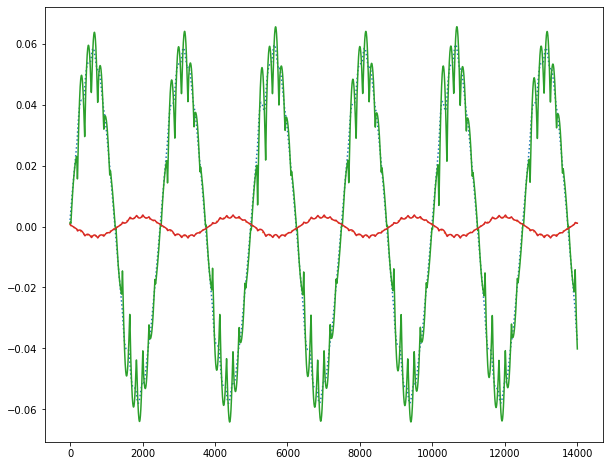

  0%|          | 1/1562 [00:00<03:38,  7.13it/s]

Epoch 0


100%|██████████| 1562/1562 [00:09<00:00, 163.84it/s]


Epoch 0 , mean error: 0.0044458024 params: [DeviceArray([[ 7.5056416e+03,  3.9804098e-03],
             [-3.0648895e-05,  7.5035854e+03]], dtype=float32), DeviceArray([[ 1.8584753e+01,  2.6357351e-03],
             [-4.4664444e-04,  1.7816019e+01]], dtype=float32)]


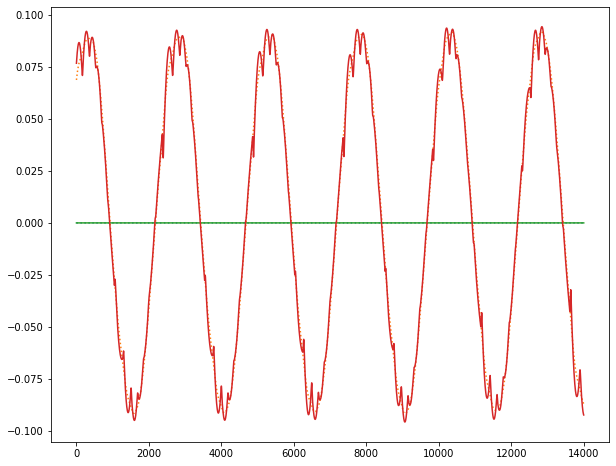

  1%|          | 18/1562 [00:00<00:09, 171.28it/s]

Epoch 1


100%|██████████| 1562/1562 [00:09<00:00, 166.60it/s]


Epoch 1 , mean error: 0.0011773886 params: [DeviceArray([[7.5035479e+03, 1.3870344e-02],
             [6.3131317e-03, 7.5046362e+03]], dtype=float32), DeviceArray([[ 1.9075605e+01, -1.1718864e-02],
             [-1.9351050e-04,  1.9253004e+01]], dtype=float32)]


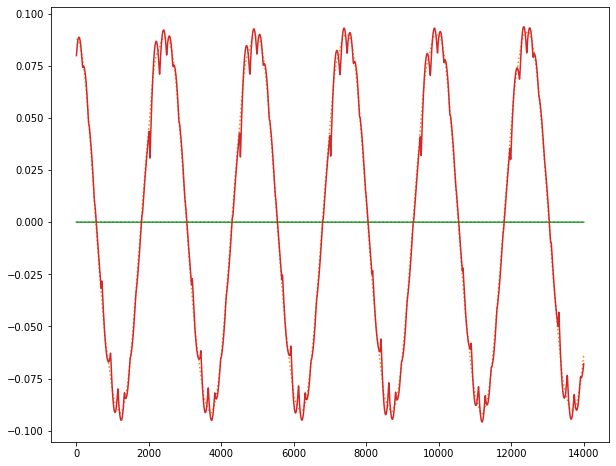

  1%|          | 17/1562 [00:00<00:09, 163.10it/s]

Epoch 2


100%|██████████| 1562/1562 [00:09<00:00, 166.21it/s]


Epoch 2 , mean error: 0.0011821763 params: [DeviceArray([[ 7.4971465e+03, -3.5371441e-01],
             [ 2.7777758e-01,  7.5044478e+03]], dtype=float32), DeviceArray([[19.149136  , -0.03224726],
             [-0.03572065, 18.262959  ]], dtype=float32)]


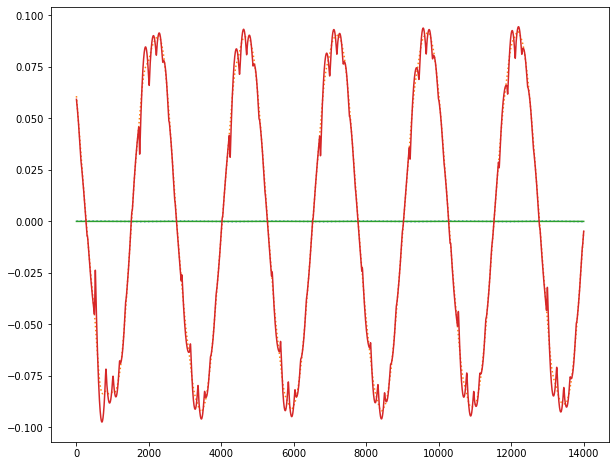

  1%|          | 18/1562 [00:00<00:08, 172.21it/s]

Epoch 3


100%|██████████| 1562/1562 [00:09<00:00, 161.38it/s]


Epoch 3 , mean error: 0.001183449 params: [DeviceArray([[7.4896108e+03, 8.2743859e-01],
             [2.5177233e+00, 7.4977954e+03]], dtype=float32), DeviceArray([[19.202946  ,  0.17454475],
             [-0.23249319, 18.209213  ]], dtype=float32)]


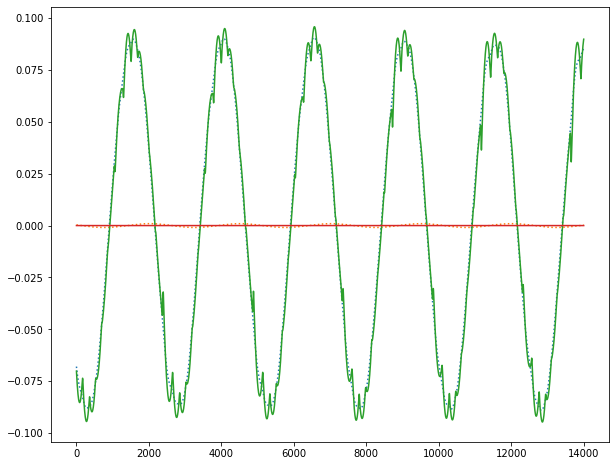

  0%|          | 1/1562 [00:00<03:31,  7.38it/s]

Epoch 0


100%|██████████| 1562/1562 [00:09<00:00, 161.34it/s]


Epoch 0 , mean error: 0.026200246 params: [DeviceArray([[11803.501  ,  -464.22983],
             [  361.3311 ,  7930.0107 ]], dtype=float32), DeviceArray([[68.11948   ,  0.35843134],
             [-7.006044  , 60.863293  ]], dtype=float32)]


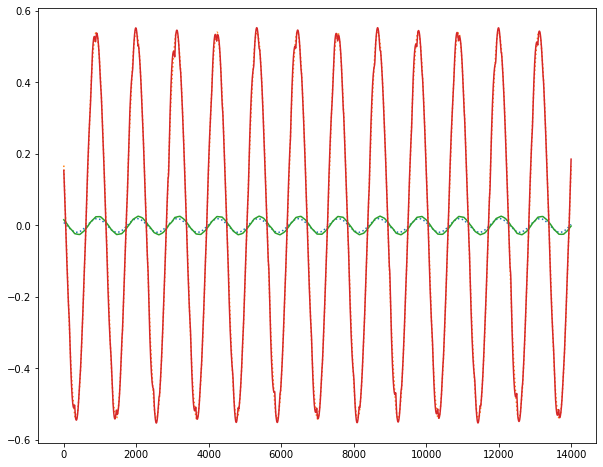

  1%|          | 18/1562 [00:00<00:08, 174.62it/s]

Epoch 1


100%|██████████| 1562/1562 [00:09<00:00, 163.77it/s]


Epoch 1 , mean error: 0.018766908 params: [DeviceArray([[11788.016  ,  -443.59744],
             [  361.5933 ,  7924.0293 ]], dtype=float32), DeviceArray([[72.35048 ,  8.557994],
             [-5.007391, 61.618378]], dtype=float32)]


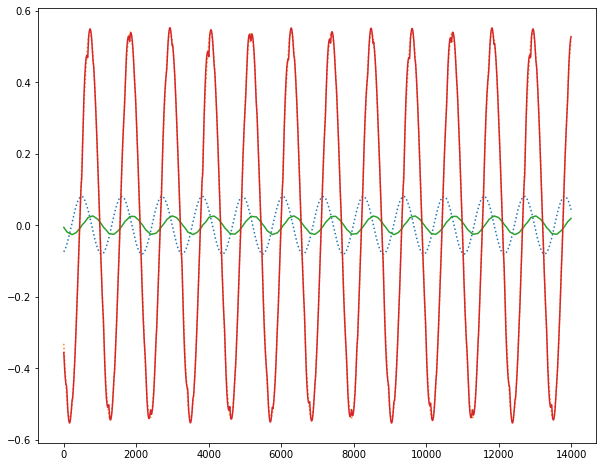

  1%|          | 17/1562 [00:00<00:09, 164.39it/s]

Epoch 2


100%|██████████| 1562/1562 [00:09<00:00, 161.32it/s]


Epoch 2 , mean error: 0.018739926 params: [DeviceArray([[11769.562  ,  -441.21625],
             [  361.67444,  7924.0864 ]], dtype=float32), DeviceArray([[72.85674  ,  8.759367 ],
             [-4.8001275, 62.542545 ]], dtype=float32)]


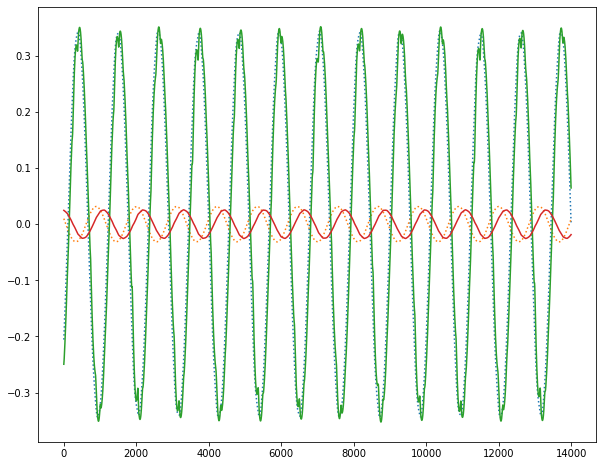

  1%|          | 16/1562 [00:00<00:09, 155.45it/s]

Epoch 3


100%|██████████| 1562/1562 [00:09<00:00, 167.64it/s]


Epoch 3 , mean error: 0.018735806 params: [DeviceArray([[11762.826  ,  -440.77222],
             [  361.23605,  7934.538  ]], dtype=float32), DeviceArray([[72.92884 ,  8.766995],
             [-4.841156, 62.67824 ]], dtype=float32)]


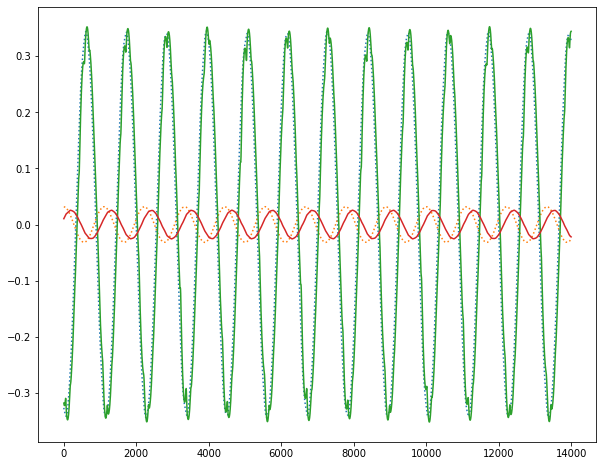

  0%|          | 1/1562 [00:00<03:32,  7.34it/s]

Epoch 0


100%|██████████| 1562/1562 [00:09<00:00, 165.74it/s]


Epoch 0 , mean error: 0.04398764 params: [DeviceArray([[7.5136392e+03, 4.2192177e-03],
             [1.2980030e-01, 7.5063262e+03]], dtype=float32), DeviceArray([[ 1.5876906e+01, -1.6855248e-04],
             [ 1.2561608e-02,  1.8605938e+01]], dtype=float32)]


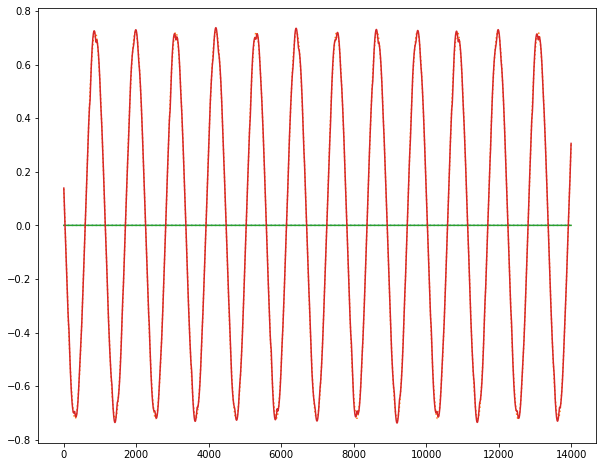

  1%|          | 16/1562 [00:00<00:10, 152.26it/s]

Epoch 1


100%|██████████| 1562/1562 [00:09<00:00, 163.09it/s]


Epoch 1 , mean error: 0.033162307 params: [DeviceArray([[ 7.5085288e+03, -4.3627806e-06],
             [-3.4793428e-01,  7.5057798e+03]], dtype=float32), DeviceArray([[ 1.6020382e+01, -1.7200172e-03],
             [ 4.7929116e-02,  1.8673838e+01]], dtype=float32)]


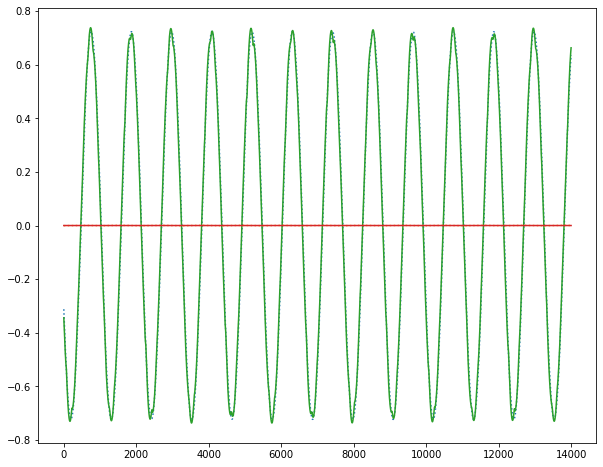

  1%|          | 16/1562 [00:00<00:09, 157.67it/s]

Epoch 2


100%|██████████| 1562/1562 [00:09<00:00, 158.17it/s]


Epoch 2 , mean error: 0.03313925 params: [DeviceArray([[ 7.4994126e+03, -2.4867687e-01],
             [ 3.1725323e+00,  7.5008198e+03]], dtype=float32), DeviceArray([[ 1.6032377e+01,  6.7195762e-04],
             [-8.6338148e-02,  1.8169455e+01]], dtype=float32)]


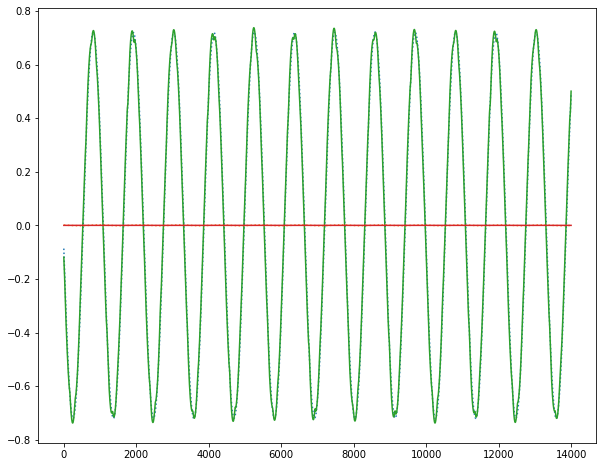

  1%|          | 15/1562 [00:00<00:10, 148.81it/s]

Epoch 3


100%|██████████| 1562/1562 [00:09<00:00, 161.03it/s]


Epoch 3 , mean error: 0.033176456 params: [DeviceArray([[ 7.4942461e+03, -3.0012531e+00],
             [-5.4769844e-01,  7.5004912e+03]], dtype=float32), DeviceArray([[16.024805  ,  0.20959502],
             [ 0.07153981, 18.306074  ]], dtype=float32)]


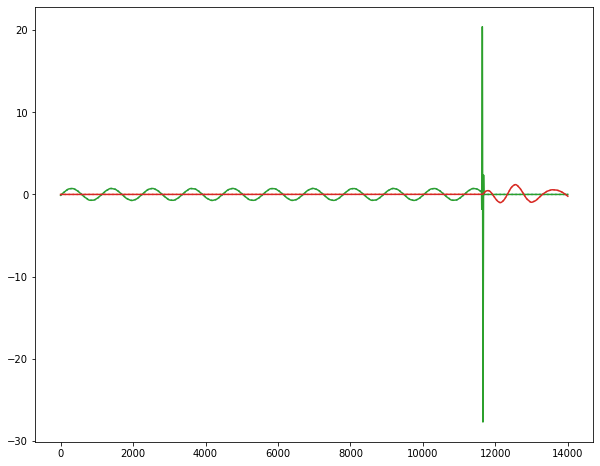

  0%|          | 1/1562 [00:00<03:29,  7.45it/s]

Epoch 0


100%|██████████| 1562/1562 [00:09<00:00, 161.05it/s]


Epoch 0 , mean error: 0.17168456 params: [DeviceArray([[11770.8545 ,  -419.03098],
             [  424.74615,  7931.53   ]], dtype=float32), DeviceArray([[72.54277   ,  0.851395  ],
             [ 0.54242057, 62.439125  ]], dtype=float32)]


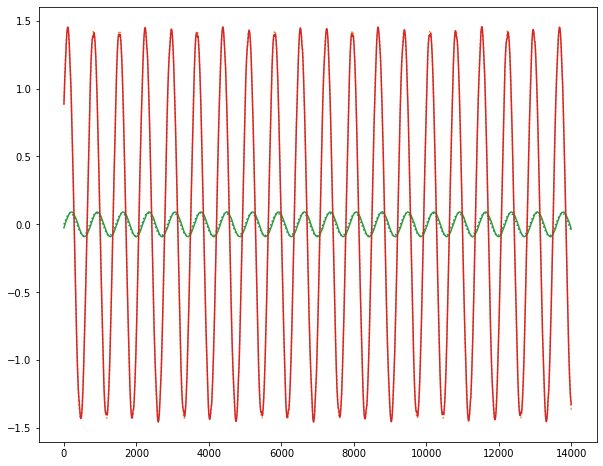

  1%|          | 18/1562 [00:00<00:09, 170.52it/s]

Epoch 1


100%|██████████| 1562/1562 [00:09<00:00, 160.25it/s]


Epoch 1 , mean error: 0.15474498 params: [DeviceArray([[11761.442  ,  -413.74594],
             [  425.4616 ,  7927.0947 ]], dtype=float32), DeviceArray([[73.31323   ,  0.64886105],
             [ 0.5452614 , 61.724827  ]], dtype=float32)]


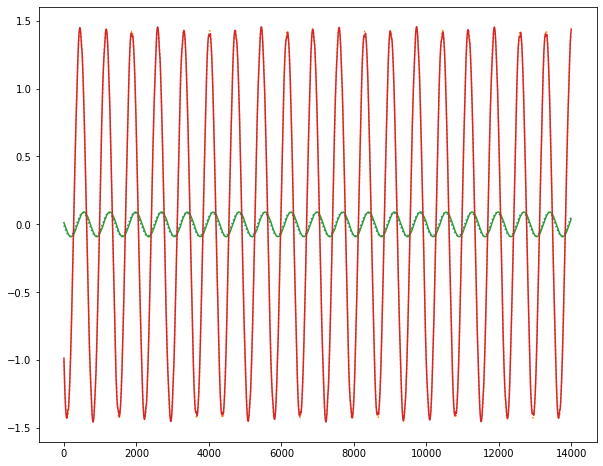

  1%|          | 18/1562 [00:00<00:08, 176.51it/s]

Epoch 2


100%|██████████| 1562/1562 [00:10<00:00, 149.07it/s]


Epoch 2 , mean error: 0.15431336 params: [DeviceArray([[11760.439  ,  -412.01807],
             [  426.37653,  7932.9663 ]], dtype=float32), DeviceArray([[73.34951  ,  0.6457169],
             [ 0.5219375, 59.490612 ]], dtype=float32)]


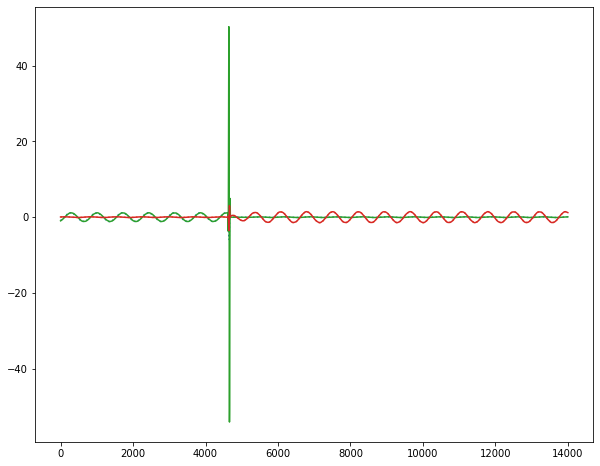

  1%|          | 17/1562 [00:00<00:09, 159.69it/s]

Epoch 3


100%|██████████| 1562/1562 [00:09<00:00, 157.24it/s]


Epoch 3 , mean error: 0.1542511 params: [DeviceArray([[11760.335  ,  -411.55344],
             [  426.21683,  7937.974  ]], dtype=float32), DeviceArray([[73.35302   ,  0.6442115 ],
             [ 0.51199317, 59.464996  ]], dtype=float32)]


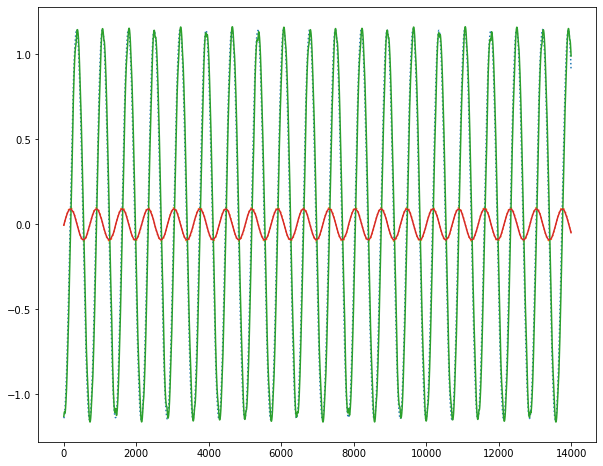

  0%|          | 1/1562 [00:00<03:40,  7.08it/s]

Epoch 0


100%|██████████| 1562/1562 [00:10<00:00, 152.29it/s]


Epoch 0 , mean error: 4.06323 params: [DeviceArray([[7.5630854e+03, 3.0086031e-03],
             [6.2927559e-02, 7.5032368e+03]], dtype=float32), DeviceArray([[ 3.0132776e+01, -9.3835537e-05],
             [ 1.9064113e-03,  1.9412632e+01]], dtype=float32)]


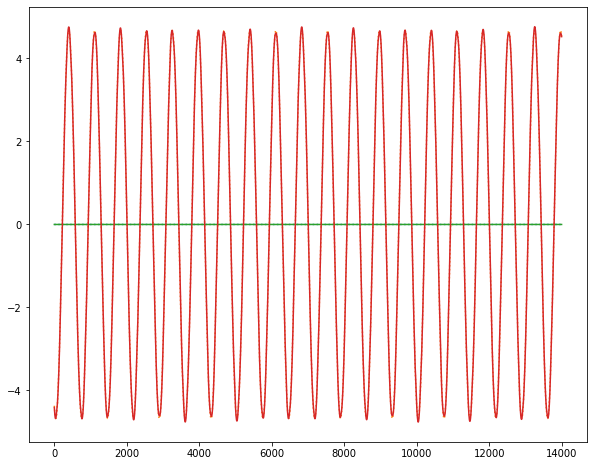

  1%|          | 17/1562 [00:00<00:09, 165.05it/s]

Epoch 1


100%|██████████| 1562/1562 [00:09<00:00, 157.11it/s]


Epoch 1 , mean error: 3.8350983 params: [DeviceArray([[ 7.5628735e+03,  2.9753316e-03],
             [-3.6527995e-02,  7.5007676e+03]], dtype=float32), DeviceArray([[2.8144730e+01, 1.0892318e-03],
             [1.2328858e-03, 1.8985289e+01]], dtype=float32)]


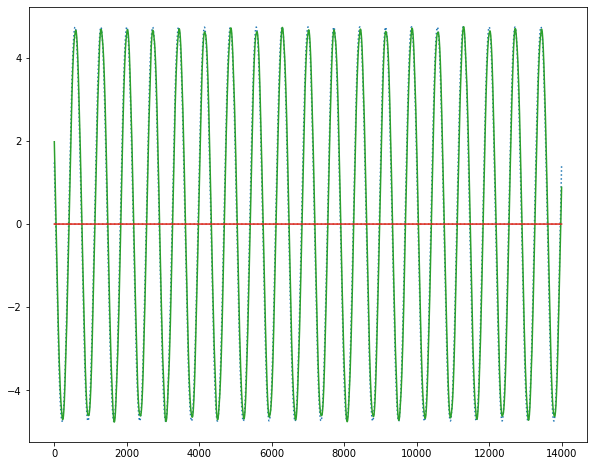

  1%|          | 18/1562 [00:00<00:08, 179.49it/s]

Epoch 2


100%|██████████| 1562/1562 [00:10<00:00, 148.47it/s]


Epoch 2 , mean error: 3.826221 params: [DeviceArray([[ 7.5628584e+03,  1.2268205e+00],
             [-4.4000205e-02,  7.4845591e+03]], dtype=float32), DeviceArray([[ 2.7629238e+01, -2.8261143e-01],
             [-4.3806387e-03,  1.8057381e+01]], dtype=float32)]


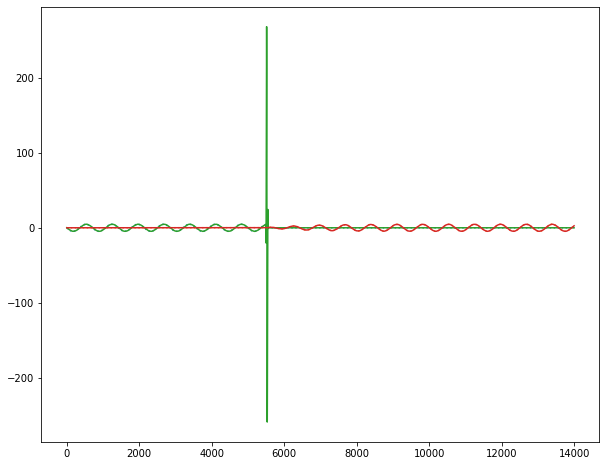

  1%|          | 16/1562 [00:00<00:10, 151.97it/s]

Epoch 3


100%|██████████| 1562/1562 [00:10<00:00, 155.72it/s]


Epoch 3 , mean error: 3.8237586 params: [DeviceArray([[ 7.5628550e+03,  1.2742057e-03],
             [-4.6419601e+00,  7.4971123e+03]], dtype=float32), DeviceArray([[ 2.7529791e+01, -1.4595705e-02],
             [ 2.0332820e+00,  1.8374355e+01]], dtype=float32)]


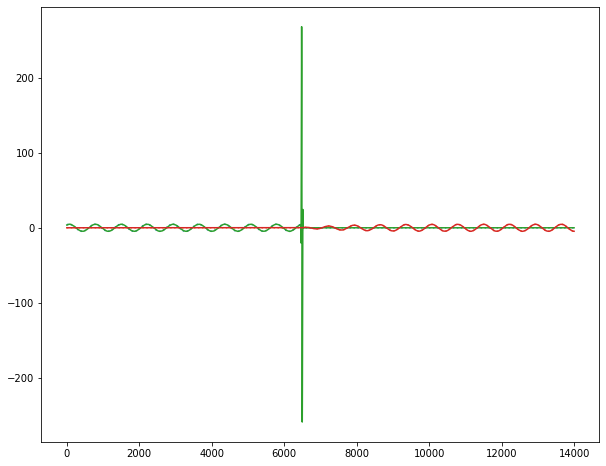

  0%|          | 1/1562 [00:00<03:53,  6.70it/s]

Epoch 0


100%|██████████| 1562/1562 [00:09<00:00, 160.34it/s]


Epoch 0 , mean error: 0.17179343 params: [DeviceArray([[12020.798   ,   -38.116688],
             [  450.92255 ,  7914.077   ]], dtype=float32), DeviceArray([[115.8868   ,   1.6138115],
             [ -6.40143  ,  62.240086 ]], dtype=float32)]


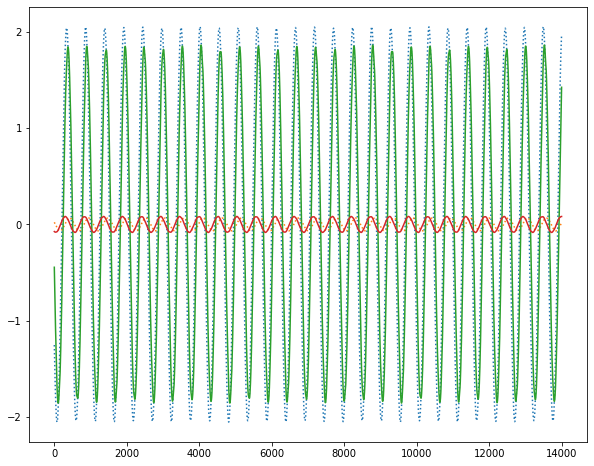

  1%|          | 17/1562 [00:00<00:09, 167.72it/s]

Epoch 1


100%|██████████| 1562/1562 [00:09<00:00, 156.68it/s]


Epoch 1 , mean error: 0.16052568 params: [DeviceArray([[12060.383  ,   -42.39989],
             [  466.47223,  7906.1753 ]], dtype=float32), DeviceArray([[112.423836  ,   0.75508547],
             [ -6.2030506 ,  59.407444  ]], dtype=float32)]


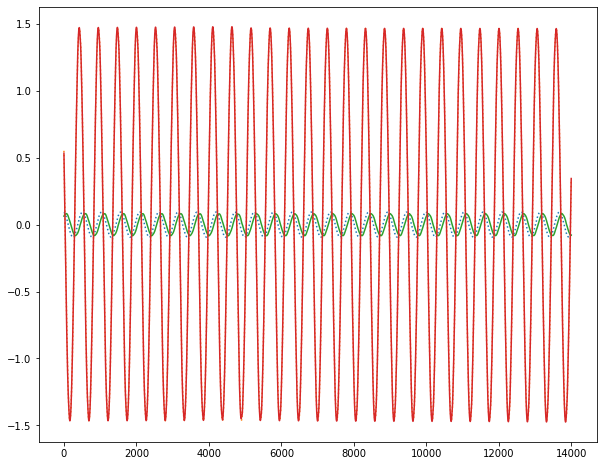

  1%|          | 14/1562 [00:00<00:11, 137.61it/s]

Epoch 2


100%|██████████| 1562/1562 [00:09<00:00, 163.31it/s]


Epoch 2 , mean error: 0.16034721 params: [DeviceArray([[12071.19    ,   -41.255005],
             [  466.27252 ,  7903.1616  ]], dtype=float32), DeviceArray([[111.71338  ,   0.7905097],
             [ -6.1819572,  61.172207 ]], dtype=float32)]


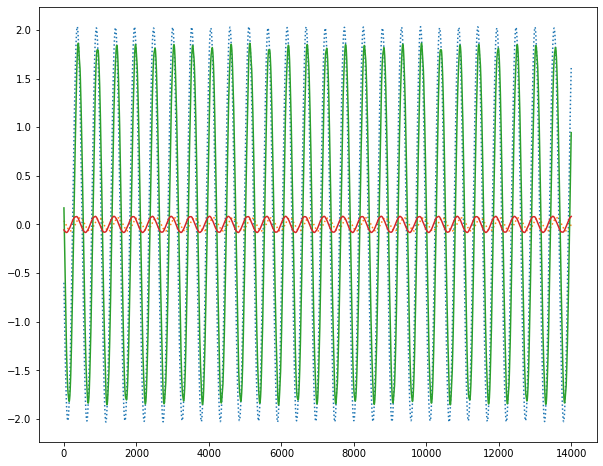

  1%|          | 18/1562 [00:00<00:08, 175.69it/s]

Epoch 3


100%|██████████| 1562/1562 [00:09<00:00, 163.40it/s]


Epoch 3 , mean error: 0.1602962 params: [DeviceArray([[12073.582   ,   -40.695705],
             [  466.14157 ,  7894.825   ]], dtype=float32), DeviceArray([[111.5795    ,   0.79872084],
             [ -6.1736445 ,  60.478817  ]], dtype=float32)]


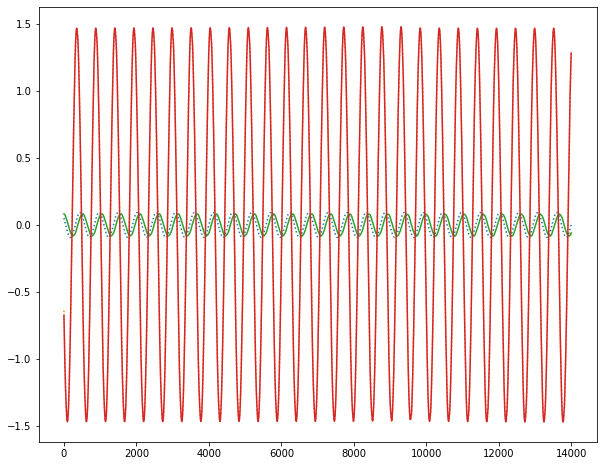

  0%|          | 1/1562 [00:00<03:38,  7.13it/s]

Epoch 0


100%|██████████| 1562/1562 [00:09<00:00, 159.32it/s]


Epoch 0 , mean error: 0.02973682 params: [DeviceArray([[ 7.4866650e+03,  5.5328310e-03],
             [-5.7584478e-04,  7.4891694e+03]], dtype=float32), DeviceArray([[ 1.6927658e+01,  7.1124109e-03],
             [-6.7070650e-05,  1.8636501e+01]], dtype=float32)]


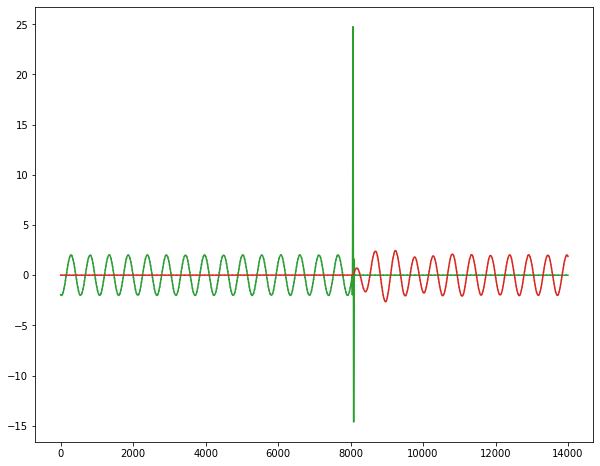

  1%|          | 16/1562 [00:00<00:10, 154.17it/s]

Epoch 1


100%|██████████| 1562/1562 [00:10<00:00, 153.80it/s]


Epoch 1 , mean error: 0.022578586 params: [DeviceArray([[7.4804316e+03, 2.8692877e-01],
             [8.3593406e-02, 7.4908779e+03]], dtype=float32), DeviceArray([[1.6840647e+01, 7.5348997e-03],
             [1.5086138e-03, 1.9933779e+01]], dtype=float32)]


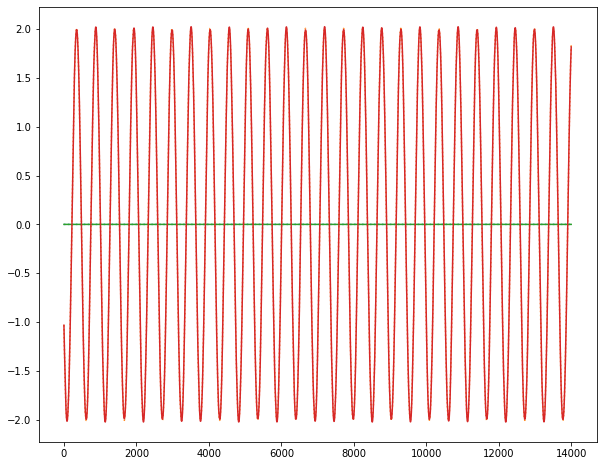

  1%|          | 12/1562 [00:00<00:13, 118.57it/s]

Epoch 2


100%|██████████| 1562/1562 [00:12<00:00, 121.71it/s]


Epoch 2 , mean error: 0.022647748 params: [DeviceArray([[ 7.4954727e+03,  3.5128322e-01],
             [-4.5896232e-02,  7.4940044e+03]], dtype=float32), DeviceArray([[1.6826797e+01, 9.0343468e-03],
             [4.0750854e-02, 1.8946440e+01]], dtype=float32)]


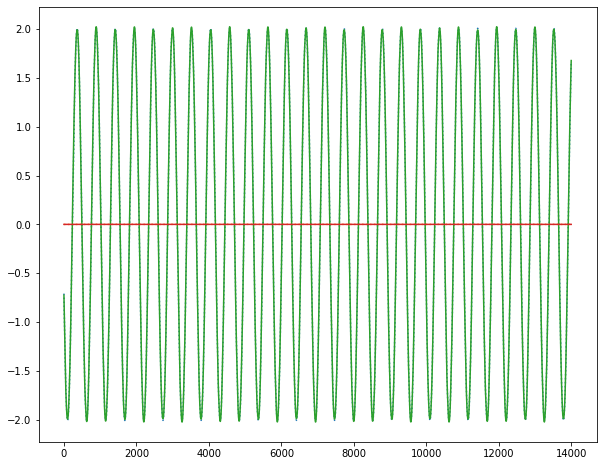

  1%|          | 14/1562 [00:00<00:11, 139.08it/s]

Epoch 3


100%|██████████| 1562/1562 [00:12<00:00, 130.09it/s]


Epoch 3 , mean error: 0.022713304 params: [DeviceArray([[ 7.4983872e+03, -5.8055816e+00],
             [-2.3415614e-02,  7.5034346e+03]], dtype=float32), DeviceArray([[1.6825571e+01, 5.1126480e-02],
             [1.5324687e-03, 1.8748499e+01]], dtype=float32)]


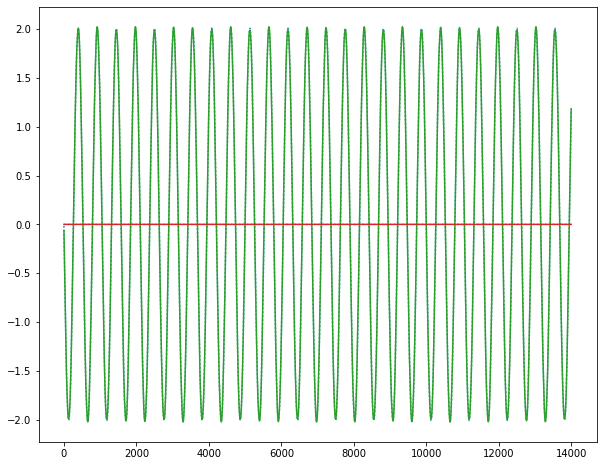

  0%|          | 1/1562 [00:00<03:28,  7.50it/s]

Epoch 0


100%|██████████| 1562/1562 [00:11<00:00, 141.66it/s]


Epoch 0 , mean error: 0.025592946 params: [DeviceArray([[11756.53   ,  -433.31827],
             [  431.36505,  7873.573  ]], dtype=float32), DeviceArray([[ 6.1607864e+01, -4.3272234e-02],
             [ 9.8275989e-03,  6.2595253e+01]], dtype=float32)]


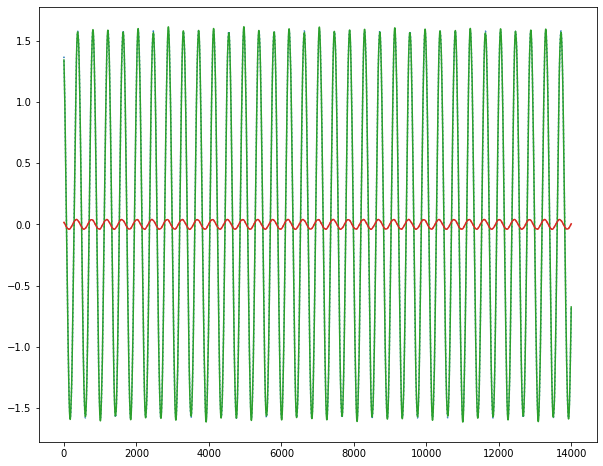

  1%|          | 15/1562 [00:00<00:10, 143.51it/s]

Epoch 1


100%|██████████| 1562/1562 [00:09<00:00, 156.37it/s]


Epoch 1 , mean error: 0.022405434 params: [DeviceArray([[11757.13  ,  -432.7822],
             [  430.7316,  7858.435 ]], dtype=float32), DeviceArray([[ 6.1547913e+01,  1.0343733e-01],
             [-3.8460754e-02,  6.0092251e+01]], dtype=float32)]


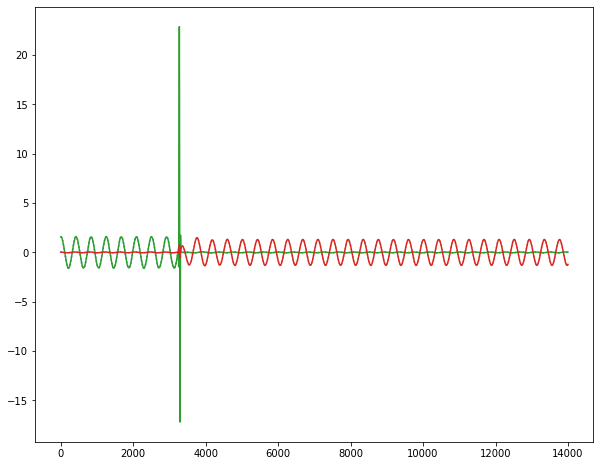

  1%|          | 18/1562 [00:00<00:08, 173.05it/s]

Epoch 2


100%|██████████| 1562/1562 [00:09<00:00, 158.83it/s]


Epoch 2 , mean error: 0.022420632 params: [DeviceArray([[11757.257  ,  -433.26245],
             [  430.98077,  7840.266  ]], dtype=float32), DeviceArray([[6.1539654e+01, 3.1563208e-02],
             [3.1265579e-02, 6.0256207e+01]], dtype=float32)]


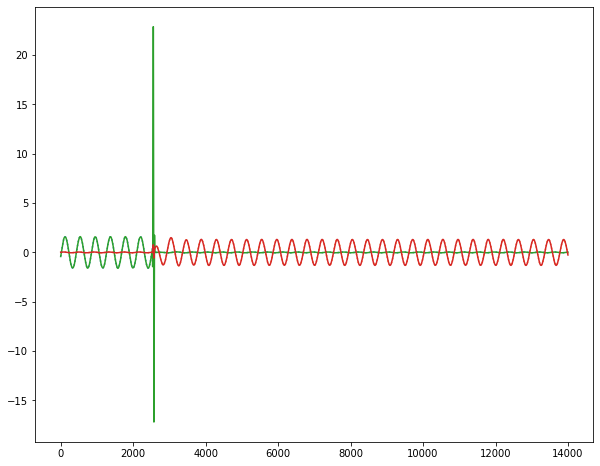

  1%|          | 17/1562 [00:00<00:09, 166.07it/s]

Epoch 3


100%|██████████| 1562/1562 [00:09<00:00, 164.00it/s]


Epoch 3 , mean error: 0.022427743 params: [DeviceArray([[11757.26   ,  -433.27216],
             [  431.05164,  7840.8657 ]], dtype=float32), DeviceArray([[6.1538628e+01, 2.8580893e-02],
             [1.7123245e-02, 6.0401848e+01]], dtype=float32)]


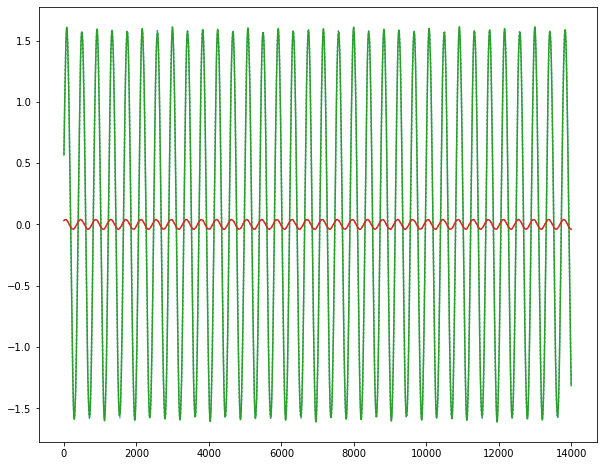

  0%|          | 1/1562 [00:00<03:24,  7.63it/s]

Epoch 0


100%|██████████| 1562/1562 [00:09<00:00, 160.44it/s]


Epoch 0 , mean error: 0.0044942065 params: [DeviceArray([[ 7.4436411e+03, -5.4413363e-02],
             [ 1.7681900e-02,  7.4430244e+03]], dtype=float32), DeviceArray([[ 1.8149696e+01,  5.2189953e-03],
             [-6.7104574e-04,  1.8853624e+01]], dtype=float32)]


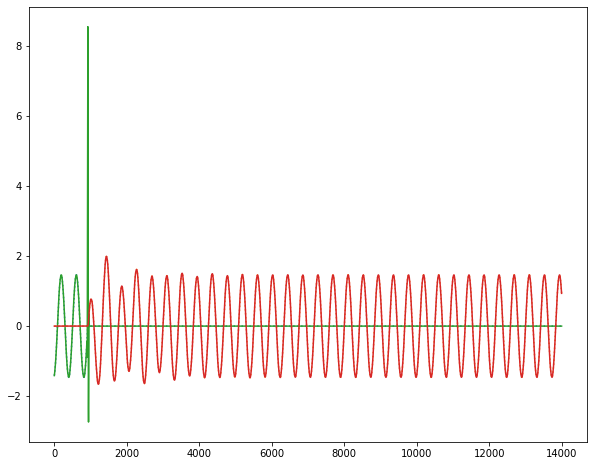

  1%|          | 18/1562 [00:00<00:08, 173.31it/s]

Epoch 1


100%|██████████| 1562/1562 [00:09<00:00, 159.64it/s]


Epoch 1 , mean error: 0.0024292038 params: [DeviceArray([[ 7.4417568e+03, -1.2658325e-01],
             [-2.0228254e-02,  7.4386978e+03]], dtype=float32), DeviceArray([[1.8023394e+01, 2.4495378e-02],
             [1.6868629e-03, 1.7941265e+01]], dtype=float32)]


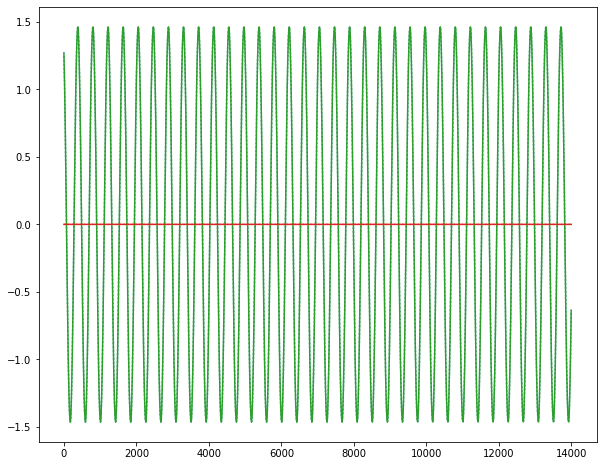

  1%|          | 19/1562 [00:00<00:08, 181.96it/s]

Epoch 2


100%|██████████| 1562/1562 [00:09<00:00, 156.86it/s]


Epoch 2 , mean error: 0.0024661247 params: [DeviceArray([[ 7.4390039e+03, -4.2759652e+00],
             [-6.7617491e-02,  7.4441523e+03]], dtype=float32), DeviceArray([[ 1.8077040e+01, -1.4473289e-02],
             [-9.0288988e-04,  1.9004850e+01]], dtype=float32)]


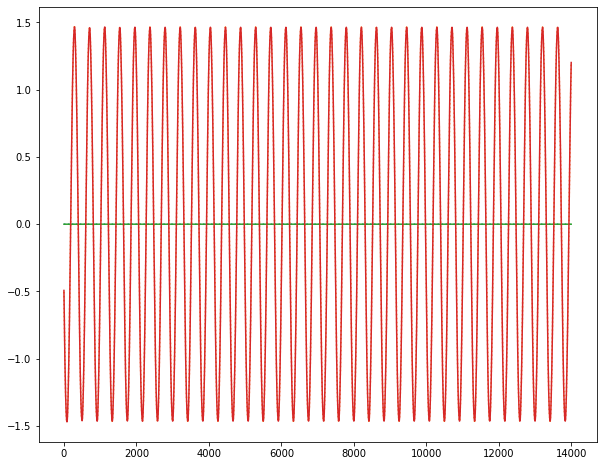

  1%|          | 18/1562 [00:00<00:08, 173.57it/s]

Epoch 3


100%|██████████| 1562/1562 [00:10<00:00, 155.93it/s]


Epoch 3 , mean error: 0.0024890455 params: [DeviceArray([[ 7.4432134e+03, -3.8919857e+01],
             [ 1.5935581e-02,  7.4426885e+03]], dtype=float32), DeviceArray([[ 1.8086252e+01, -2.0573938e+00],
             [ 3.9673210e-03,  1.9069410e+01]], dtype=float32)]


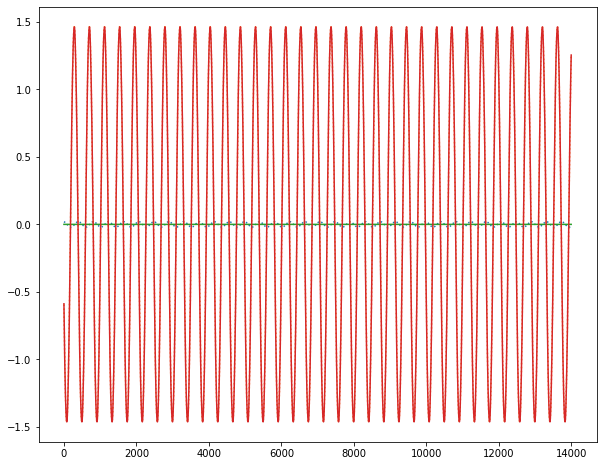

  0%|          | 1/1562 [00:00<03:55,  6.63it/s]

Epoch 0


100%|██████████| 1562/1562 [00:09<00:00, 161.85it/s]


Epoch 0 , mean error: 0.005773965 params: [DeviceArray([[11762.725  ,  -419.62375],
             [  436.83267,  7797.458  ]], dtype=float32), DeviceArray([[45.47848  ,  1.3270028],
             [ 0.5076102, 62.147354 ]], dtype=float32)]


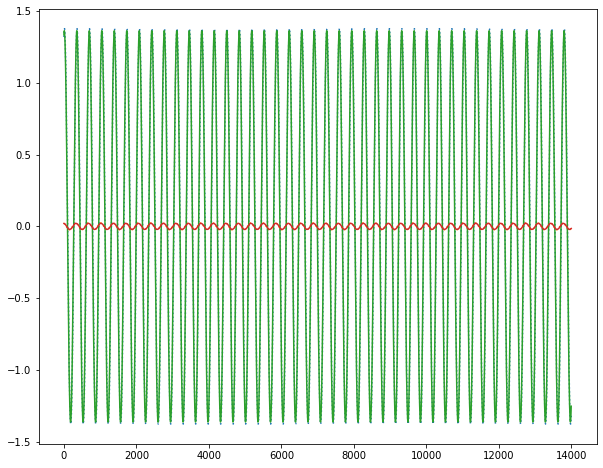

  1%|          | 17/1562 [00:00<00:09, 164.16it/s]

Epoch 1


100%|██████████| 1562/1562 [00:09<00:00, 163.85it/s]


Epoch 1 , mean error: 0.004417074 params: [DeviceArray([[11783.143 ,  -405.6486],
             [  410.4517,  7803.1865]], dtype=float32), DeviceArray([[45.489567  ,  3.0423775 ],
             [ 0.18483722, 63.616695  ]], dtype=float32)]


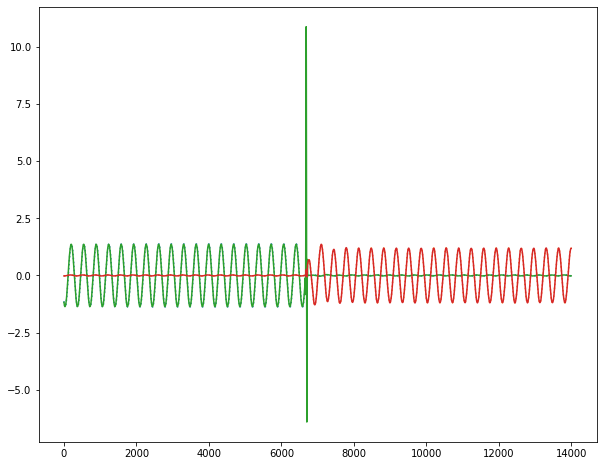

  1%|          | 17/1562 [00:00<00:09, 168.64it/s]

Epoch 2


100%|██████████| 1562/1562 [00:09<00:00, 169.97it/s]


Epoch 2 , mean error: 0.0044306885 params: [DeviceArray([[11806.294  ,  -427.82056],
             [  441.80246,  7806.5913 ]], dtype=float32), DeviceArray([[45.46442  , -7.177864 ],
             [-1.9077394, 63.423157 ]], dtype=float32)]


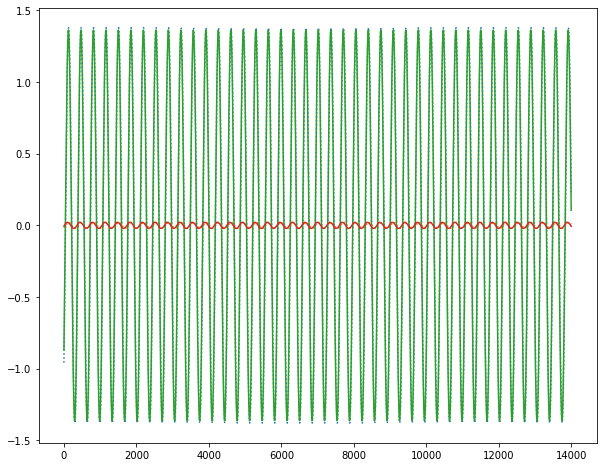

  1%|          | 18/1562 [00:00<00:08, 176.69it/s]

Epoch 3


100%|██████████| 1562/1562 [00:09<00:00, 161.92it/s]


Epoch 3 , mean error: 0.0044360743 params: [DeviceArray([[11824.762  ,  -435.92758],
             [  429.5429 ,  7801.547  ]], dtype=float32), DeviceArray([[45.437668  , -5.803124  ],
             [ 0.96840674, 63.468414  ]], dtype=float32)]


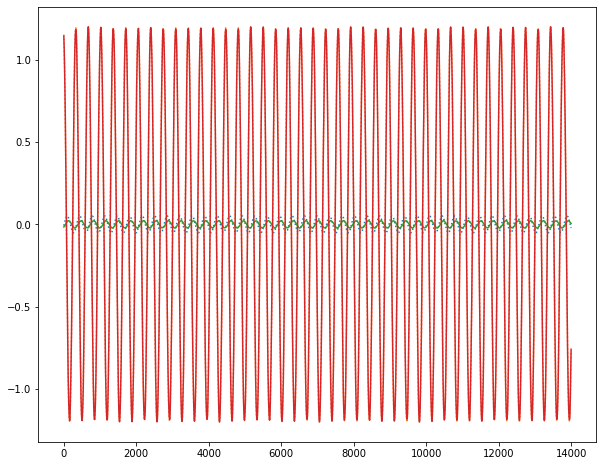

  0%|          | 1/1562 [00:00<03:26,  7.54it/s]

Epoch 0


100%|██████████| 1562/1562 [00:09<00:00, 158.38it/s]


Epoch 0 , mean error: 0.0018354031 params: [DeviceArray([[ 7.3487617e+03,  4.9621932e-02],
             [-2.1541789e-02,  7.3398506e+03]], dtype=float32), DeviceArray([[ 1.7923697e+01, -2.1381997e-02],
             [-9.9613704e-03,  1.8316933e+01]], dtype=float32)]


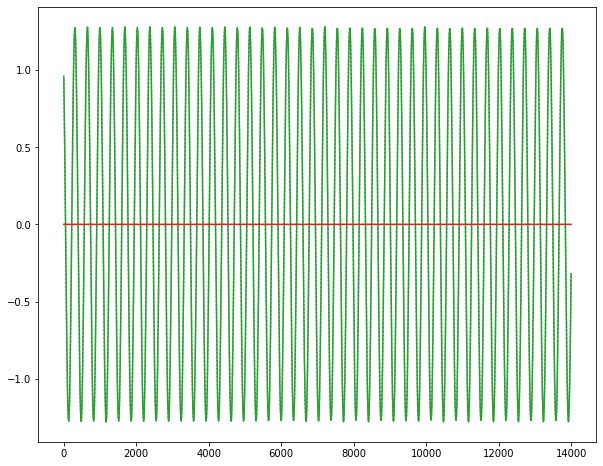

  1%|          | 16/1562 [00:00<00:10, 154.04it/s]

Epoch 1


100%|██████████| 1562/1562 [00:09<00:00, 160.87it/s]


Epoch 1 , mean error: 0.0008062853 params: [DeviceArray([[ 7.3441558e+03, -3.4413761e-01],
             [-1.2230061e-01,  7.3433774e+03]], dtype=float32), DeviceArray([[17.590342  , -0.07216115],
             [ 0.02041624, 17.329105  ]], dtype=float32)]


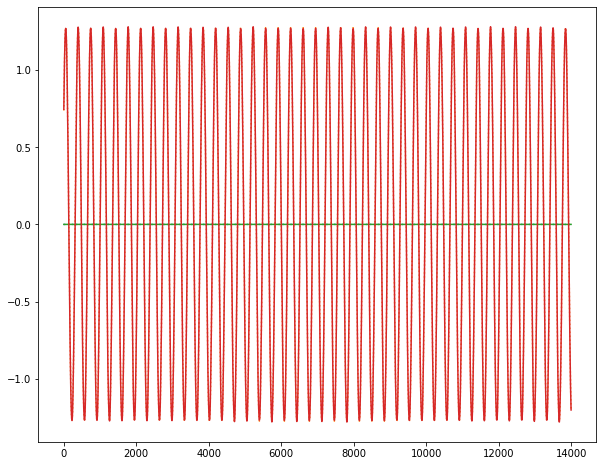

  1%|          | 16/1562 [00:00<00:09, 157.14it/s]

Epoch 2


100%|██████████| 1562/1562 [00:09<00:00, 159.02it/s]


Epoch 2 , mean error: 0.00082460255 params: [DeviceArray([[ 7.3418740e+03, -9.8415875e-01],
             [ 1.9211540e+00,  7.3501729e+03]], dtype=float32), DeviceArray([[17.513063  ,  0.25935805],
             [-1.9568219 , 17.922508  ]], dtype=float32)]


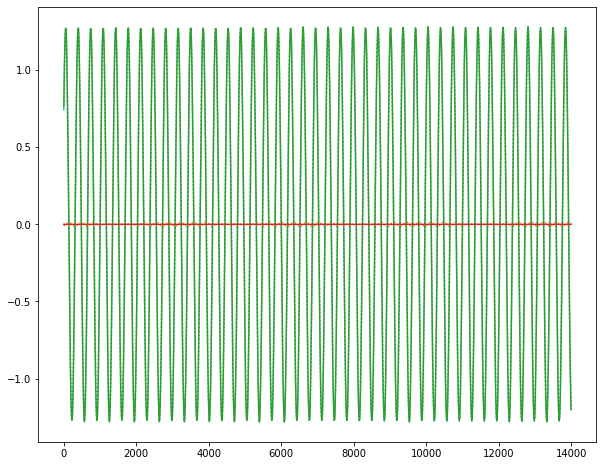

  1%|          | 17/1562 [00:00<00:09, 160.83it/s]

Epoch 3


100%|██████████| 1562/1562 [00:09<00:00, 165.95it/s]


Epoch 3 , mean error: 0.0008379056 params: [DeviceArray([[ 7.3341450e+03, -3.7827346e-01],
             [-4.8041013e-01,  7.3625674e+03]], dtype=float32), DeviceArray([[ 1.7513483e+01,  2.0230380e-01],
             [-8.7059382e-03,  1.9043539e+01]], dtype=float32)]


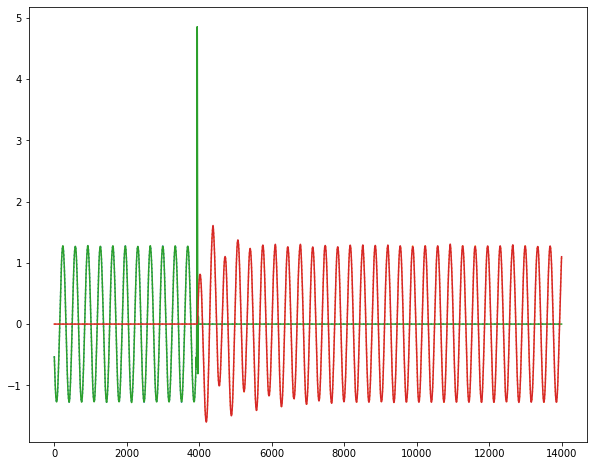

  0%|          | 1/1562 [00:00<03:22,  7.71it/s]

Epoch 0


100%|██████████| 1562/1562 [00:09<00:00, 159.17it/s]


Epoch 0 , mean error: 0.0021501074 params: [DeviceArray([[11553.246  ,  -436.9138 ],
             [  437.05823,  7633.5527 ]], dtype=float32), DeviceArray([[60.389572  , -0.12828866],
             [ 0.08477613, 61.044765  ]], dtype=float32)]


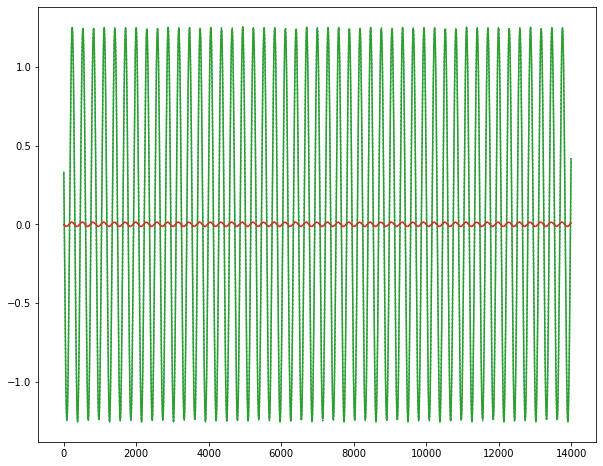

  1%|          | 17/1562 [00:00<00:09, 164.85it/s]

Epoch 1


100%|██████████| 1562/1562 [00:10<00:00, 155.00it/s]


Epoch 1 , mean error: 0.0014384945 params: [DeviceArray([[11542.727 ,  -433.873 ],
             [  433.6344,  7645.4727]], dtype=float32), DeviceArray([[ 6.0620827e+01, -2.5175363e-03],
             [-2.9438607e-02,  5.9839466e+01]], dtype=float32)]


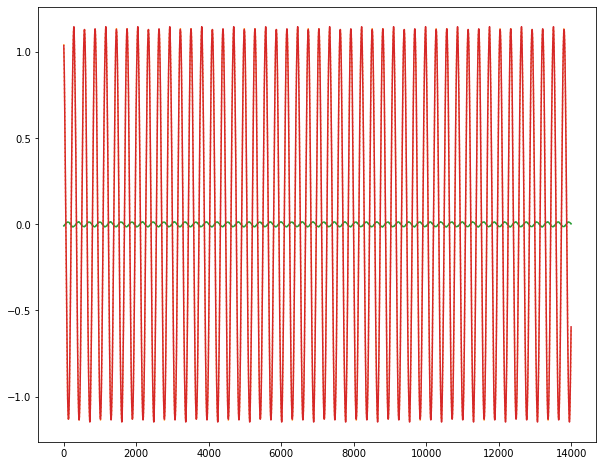

  1%|          | 18/1562 [00:00<00:08, 174.31it/s]

Epoch 2


100%|██████████| 1562/1562 [00:10<00:00, 155.97it/s]


Epoch 2 , mean error: 0.0014516886 params: [DeviceArray([[11502.909  ,  -439.60983],
             [  426.92953,  7631.457  ]], dtype=float32), DeviceArray([[6.0666615e+01, 9.3243748e-02],
             [2.7463675e-02, 5.9863625e+01]], dtype=float32)]


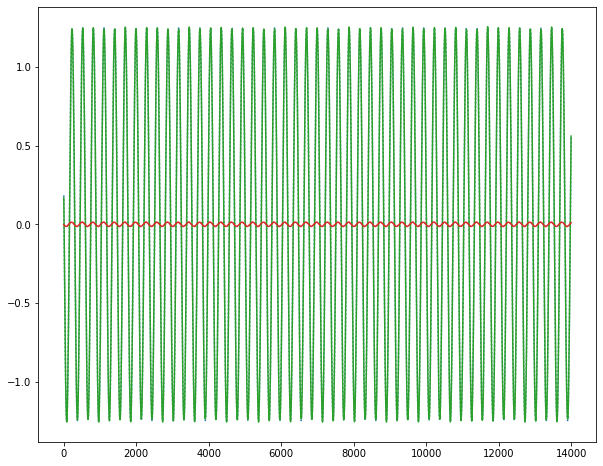

  1%|          | 15/1562 [00:00<00:10, 145.49it/s]

Epoch 3


100%|██████████| 1562/1562 [00:10<00:00, 149.26it/s]


Epoch 3 , mean error: 0.0014549416 params: [DeviceArray([[11484.725  ,  -439.1533 ],
             [  443.79083,  7633.6035 ]], dtype=float32), DeviceArray([[60.661327 ,  0.1915378],
             [-1.0254121, 59.906967 ]], dtype=float32)]


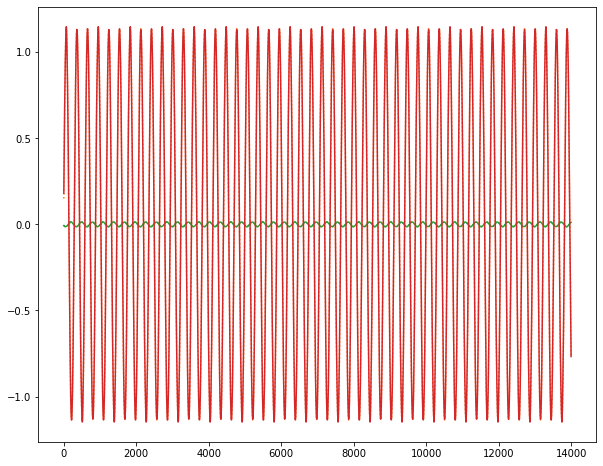

  0%|          | 1/1562 [00:00<03:20,  7.77it/s]

Epoch 0


100%|██████████| 1562/1562 [00:10<00:00, 155.73it/s]


Epoch 0 , mean error: 0.0011518317 params: [DeviceArray([[7.1904097e+03, 6.8150163e-01],
             [2.2306754e-03, 7.2049561e+03]], dtype=float32), DeviceArray([[ 1.8788139e+01, -7.0999689e-02],
             [ 4.8346532e-04,  2.0502602e+01]], dtype=float32)]


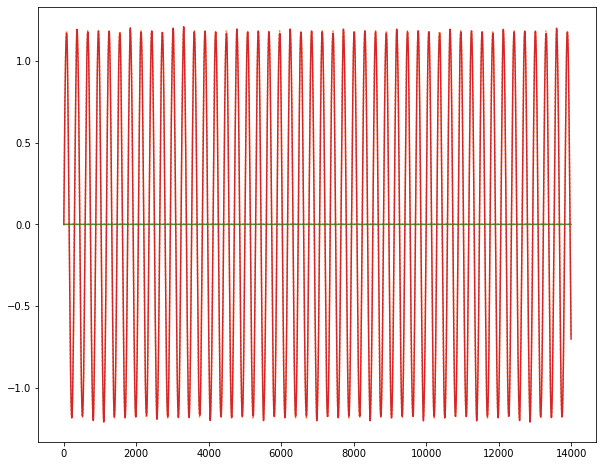

  1%|          | 17/1562 [00:00<00:09, 163.00it/s]

Epoch 1


100%|██████████| 1562/1562 [00:09<00:00, 161.72it/s]


Epoch 1 , mean error: 0.000506467 params: [DeviceArray([[ 7.1787197e+03,  3.8186908e-02],
             [-9.4663566e-03,  7.1998818e+03]], dtype=float32), DeviceArray([[ 1.5848579e+01, -4.8488036e-02],
             [-7.3740981e-04,  1.8158573e+01]], dtype=float32)]


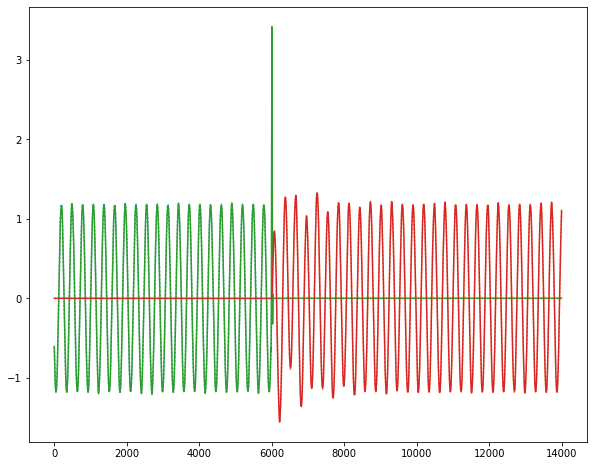

  1%|          | 15/1562 [00:00<00:10, 148.35it/s]

Epoch 2


100%|██████████| 1562/1562 [00:09<00:00, 163.25it/s]


Epoch 2 , mean error: 0.0005146161 params: [DeviceArray([[ 7.1865859e+03, -1.1772925e+00],
             [ 9.0915863e+01,  7.1990464e+03]], dtype=float32), DeviceArray([[16.096117  ,  0.08175953],
             [ 3.2849374 , 18.477654  ]], dtype=float32)]


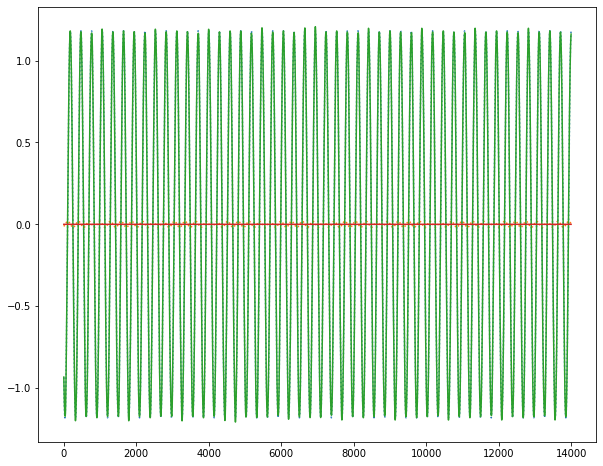

  1%|          | 17/1562 [00:00<00:09, 169.45it/s]

Epoch 3


100%|██████████| 1562/1562 [00:09<00:00, 167.28it/s]


Epoch 3 , mean error: 0.0005206311 params: [DeviceArray([[7.1932197e+03, 4.8054295e+00],
             [6.1114039e-02, 7.1973813e+03]], dtype=float32), DeviceArray([[ 1.6126225e+01, -2.1862921e-01],
             [ 5.7148910e-04,  1.8504631e+01]], dtype=float32)]


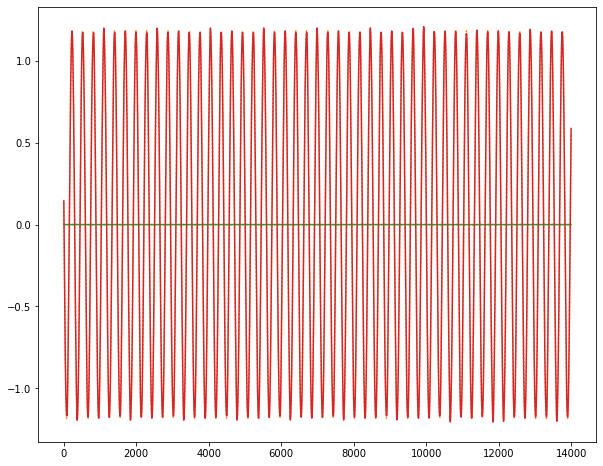

  0%|          | 1/1562 [00:00<03:34,  7.29it/s]

Epoch 0


100%|██████████| 1562/1562 [00:09<00:00, 163.30it/s]


Epoch 0 , mean error: 0.0011600929 params: [DeviceArray([[11284.737  ,  -442.04672],
             [  436.20352,  7438.397  ]], dtype=float32), DeviceArray([[6.3166553e+01, 6.0514398e-02],
             [6.1590772e-02, 6.0008041e+01]], dtype=float32)]


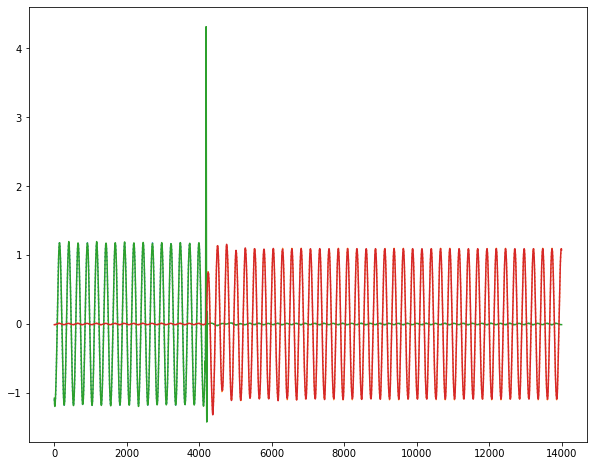

  1%|          | 16/1562 [00:00<00:09, 156.44it/s]

Epoch 1


100%|██████████| 1562/1562 [00:10<00:00, 153.74it/s]


Epoch 1 , mean error: 0.00072374736 params: [DeviceArray([[11273.804  ,  -446.4844 ],
             [  437.61237,  7418.693  ]], dtype=float32), DeviceArray([[66.738815  , -0.07436968],
             [-0.09314102, 61.377693  ]], dtype=float32)]


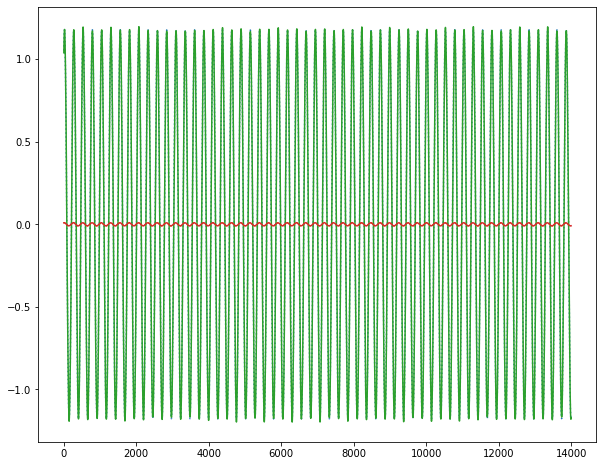

  1%|          | 15/1562 [00:00<00:11, 139.95it/s]

Epoch 2


100%|██████████| 1562/1562 [00:09<00:00, 159.34it/s]


Epoch 2 , mean error: 0.0007281105 params: [DeviceArray([[11254.588  ,  -449.43393],
             [  446.0772 ,  7405.224  ]], dtype=float32), DeviceArray([[67.0108    ,  0.11332925],
             [ 0.9299472 , 61.457134  ]], dtype=float32)]


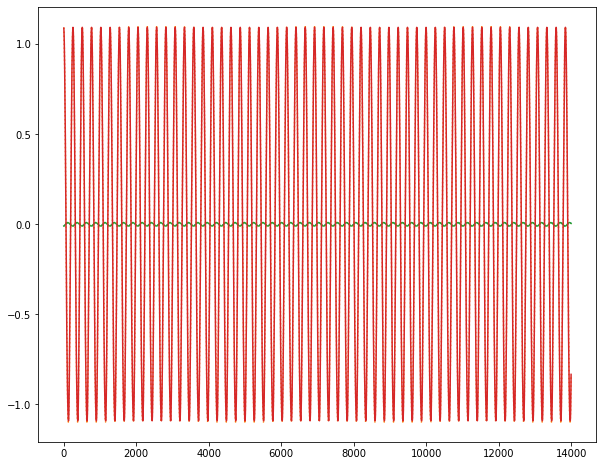

  1%|          | 14/1562 [00:00<00:11, 135.94it/s]

Epoch 3


100%|██████████| 1562/1562 [00:09<00:00, 161.63it/s]


Epoch 3 , mean error: 0.0007333847 params: [DeviceArray([[11234.298  ,  -451.20596],
             [  438.8563 ,  7400.597  ]], dtype=float32), DeviceArray([[67.04228   , -0.28652585],
             [ 0.34294188, 61.4484    ]], dtype=float32)]


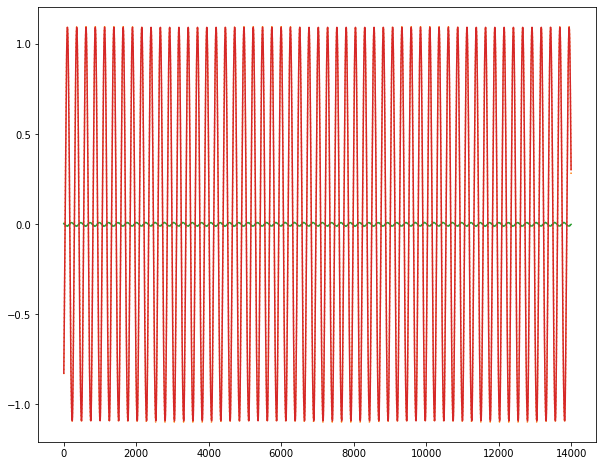

  0%|          | 1/1562 [00:00<03:29,  7.44it/s]

Epoch 0


100%|██████████| 1562/1562 [00:09<00:00, 161.53it/s]


Epoch 0 , mean error: 0.00076482253 params: [DeviceArray([[ 6.9424951e+03,  2.6072174e-02],
             [-1.0355366e-01,  6.9059292e+03]], dtype=float32), DeviceArray([[ 1.8999184e+01, -6.6584442e-04],
             [-8.0900108e-03,  1.6926367e+01]], dtype=float32)]


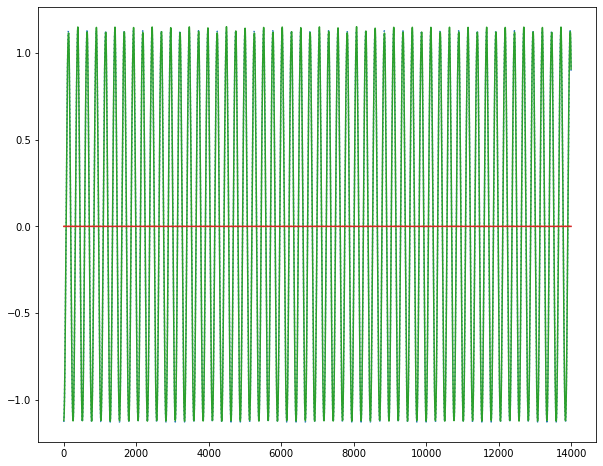

  1%|          | 17/1562 [00:00<00:09, 166.57it/s]

Epoch 1


100%|██████████| 1562/1562 [00:10<00:00, 154.00it/s]


Epoch 1 , mean error: 0.00040567853 params: [DeviceArray([[6.96204150e+03, 1.23021126e-01],
             [5.58184028e-01, 6.93665332e+03]], dtype=float32), DeviceArray([[ 2.3146145e+01,  3.0779361e-04],
             [-3.3660002e-02,  1.8183739e+01]], dtype=float32)]


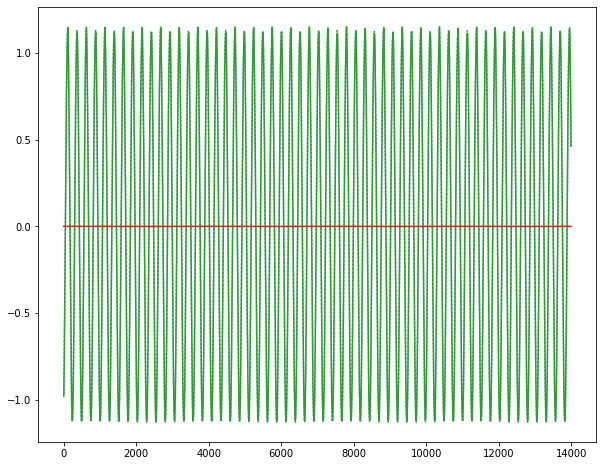

  1%|          | 16/1562 [00:00<00:09, 157.30it/s]

Epoch 2


100%|██████████| 1562/1562 [00:09<00:00, 157.99it/s]


Epoch 2 , mean error: 0.00041346147 params: [DeviceArray([[ 6.9741108e+03,  4.9339657e+00],
             [-1.0062690e+00,  6.9549678e+03]], dtype=float32), DeviceArray([[23.253323  , -0.24186881],
             [-0.02664984, 17.777515  ]], dtype=float32)]


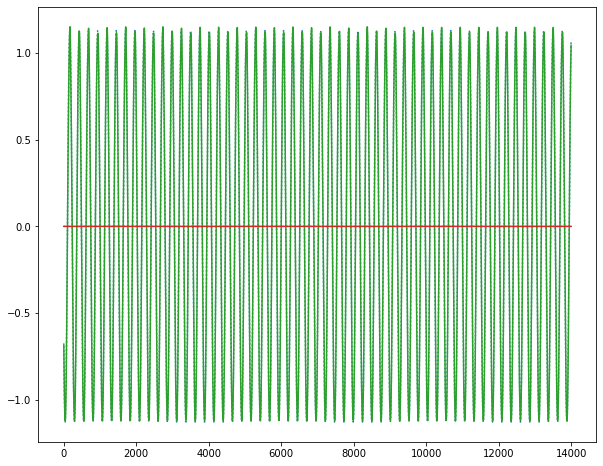

  1%|          | 18/1562 [00:00<00:08, 171.93it/s]

Epoch 3


100%|██████████| 1562/1562 [00:09<00:00, 162.75it/s]


Epoch 3 , mean error: 0.00041684843 params: [DeviceArray([[ 6.9774941e+03, -1.3331363e+01],
             [ 6.4133215e-01,  6.9600645e+03]], dtype=float32), DeviceArray([[ 2.3249495e+01,  6.5447897e-01],
             [-1.0078002e-02,  1.7778341e+01]], dtype=float32)]


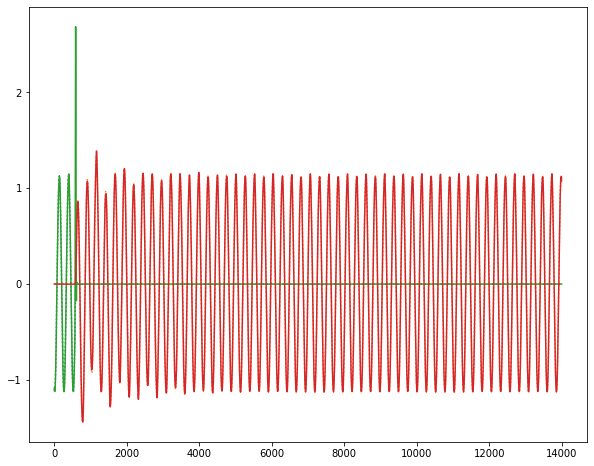

  0%|          | 1/1562 [00:00<03:25,  7.58it/s]

Epoch 0


100%|██████████| 1562/1562 [00:09<00:00, 168.39it/s]


Epoch 0 , mean error: 0.0007597981 params: [DeviceArray([[10978.359  ,  -450.562  ],
             [  442.33636,  7087.1855 ]], dtype=float32), DeviceArray([[ 5.8265995e+01, -8.4394485e-02],
             [-1.5037466e-02,  6.0872498e+01]], dtype=float32)]


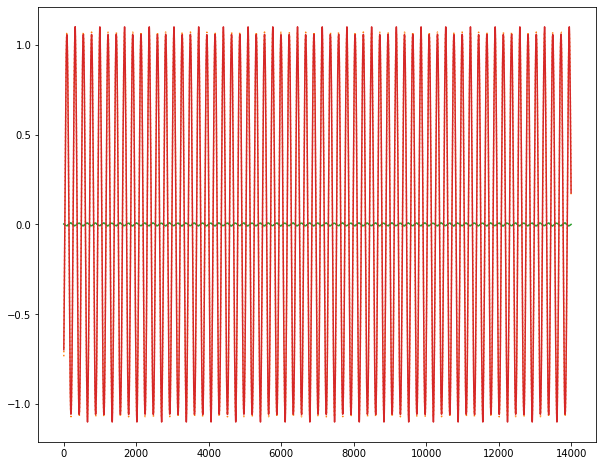

  1%|          | 17/1562 [00:00<00:09, 161.93it/s]

Epoch 1


100%|██████████| 1562/1562 [00:09<00:00, 162.10it/s]


Epoch 1 , mean error: 0.00047957493 params: [DeviceArray([[10974.521  ,  -455.99338],
             [  440.29584,  7092.0327 ]], dtype=float32), DeviceArray([[ 5.9484325e+01, -4.3129072e-02],
             [-5.2899886e-02,  5.8676868e+01]], dtype=float32)]


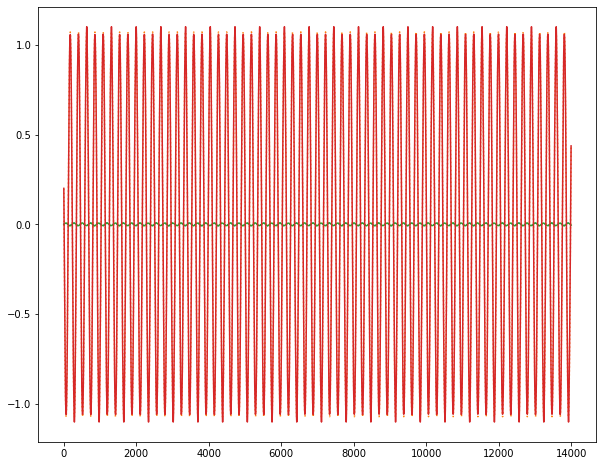

  1%|          | 17/1562 [00:00<00:09, 168.54it/s]

Epoch 2


100%|██████████| 1562/1562 [00:09<00:00, 162.71it/s]


Epoch 2 , mean error: 0.00048340077 params: [DeviceArray([[10985.467  ,  -455.6387 ],
             [  446.72437,  7091.956  ]], dtype=float32), DeviceArray([[59.59926  ,  0.0978435],
             [ 0.3694649, 58.88865  ]], dtype=float32)]


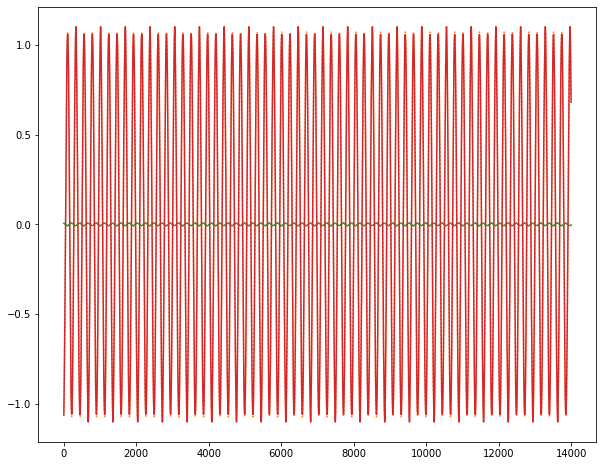

  1%|          | 17/1562 [00:00<00:09, 159.32it/s]

Epoch 3


100%|██████████| 1562/1562 [00:09<00:00, 161.78it/s]


Epoch 3 , mean error: 0.00048430357 params: [DeviceArray([[11002.908  ,  -456.35272],
             [  446.19577,  7091.8833 ]], dtype=float32), DeviceArray([[5.9600548e+01, 1.9352332e-02],
             [3.6828324e-01, 5.8926472e+01]], dtype=float32)]


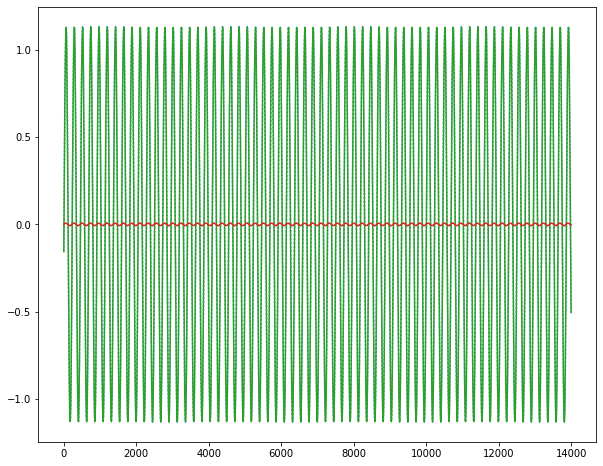

  0%|          | 1/1562 [00:00<03:31,  7.38it/s]

Epoch 0


100%|██████████| 1562/1562 [00:10<00:00, 154.70it/s]


Epoch 0 , mean error: 0.0005826346 params: [DeviceArray([[ 6.5171045e+03, -2.0194322e-01],
             [ 2.6758213e-02,  6.4952378e+03]], dtype=float32), DeviceArray([[ 1.7330128e+01, -1.3993257e-01],
             [-1.3797762e-03,  1.3777794e+01]], dtype=float32)]


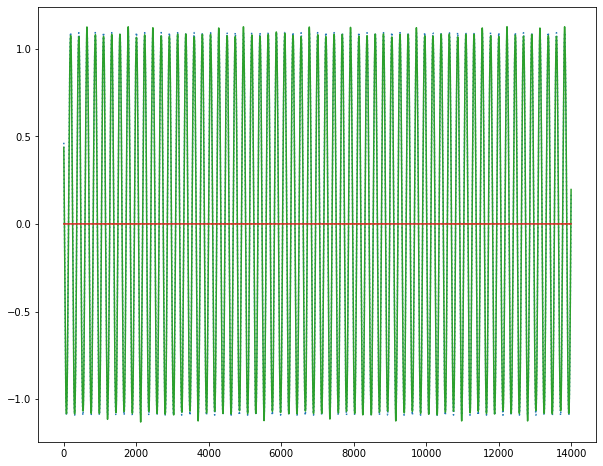

  1%|          | 15/1562 [00:00<00:10, 147.97it/s]

Epoch 1


100%|██████████| 1562/1562 [00:09<00:00, 165.96it/s]


Epoch 1 , mean error: 0.00034402308 params: [DeviceArray([[6.5349717e+03, 1.0466723e+00],
             [4.2588070e-02, 6.4941050e+03]], dtype=float32), DeviceArray([[1.6469627e+01, 4.0233359e-02],
             [2.1658596e-03, 1.5104944e+01]], dtype=float32)]


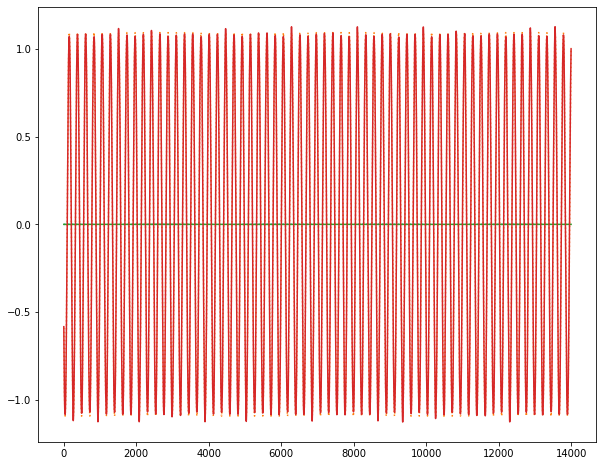

  1%|          | 16/1562 [00:00<00:09, 157.15it/s]

Epoch 2


100%|██████████| 1562/1562 [00:09<00:00, 162.66it/s]


Epoch 2 , mean error: 0.00035174907 params: [DeviceArray([[ 6.5356738e+03, -5.6665721e+00],
             [ 3.5667036e-02,  6.4838853e+03]], dtype=float32), DeviceArray([[ 1.6727835e+01,  3.1580526e-01],
             [-6.4201518e-03,  1.5083288e+01]], dtype=float32)]


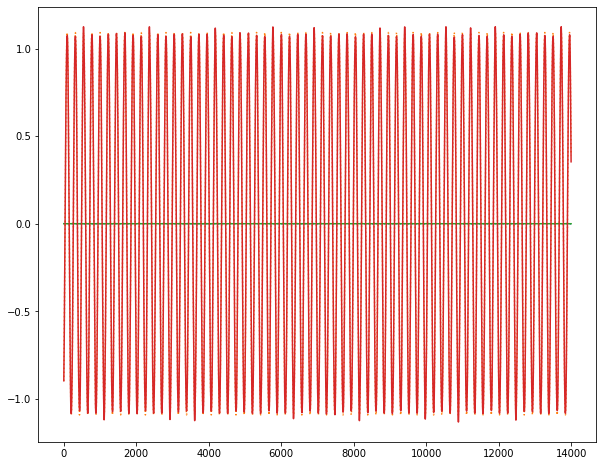

  1%|          | 17/1562 [00:00<00:09, 161.51it/s]

Epoch 3


100%|██████████| 1562/1562 [00:10<00:00, 154.81it/s]


Epoch 3 , mean error: 0.00035365598 params: [DeviceArray([[ 6.5356431e+03, -2.7453026e-01],
             [-1.9523060e+01,  6.4809004e+03]], dtype=float32), DeviceArray([[16.74229  , -0.2765601],
             [ 2.0362787, 15.084114 ]], dtype=float32)]


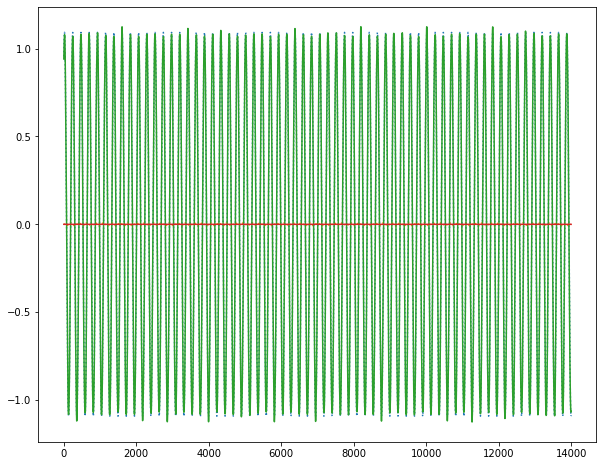

  0%|          | 1/1562 [00:00<04:06,  6.32it/s]

Epoch 0


100%|██████████| 1562/1562 [00:09<00:00, 162.82it/s]


Epoch 0 , mean error: 0.00059529115 params: [DeviceArray([[10444.567  ,  -463.00772],
             [  442.52686,  6473.2715 ]], dtype=float32), DeviceArray([[ 6.7973572e+01,  4.1146511e-03],
             [-3.7966870e-02,  6.2262978e+01]], dtype=float32)]


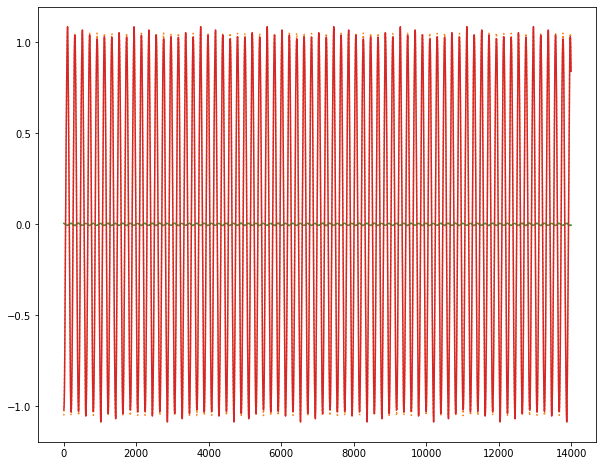

  1%|          | 17/1562 [00:00<00:09, 166.50it/s]

Epoch 1


100%|██████████| 1562/1562 [00:09<00:00, 163.06it/s]


Epoch 1 , mean error: 0.00039182743 params: [DeviceArray([[10465.662 ,  -456.1559],
             [  442.1903,  6448.9736]], dtype=float32), DeviceArray([[ 6.5503319e+01, -8.1811592e-02],
             [-2.5012270e-03,  6.0350483e+01]], dtype=float32)]


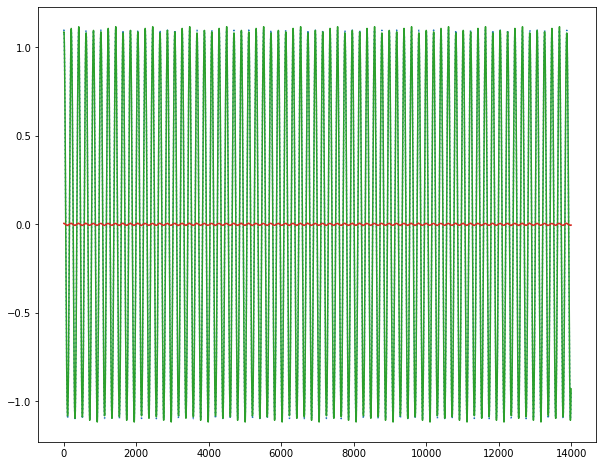

  1%|          | 17/1562 [00:00<00:09, 159.94it/s]

Epoch 2


100%|██████████| 1562/1562 [00:09<00:00, 160.02it/s]


Epoch 2 , mean error: 0.00039565517 params: [DeviceArray([[10477.391  ,  -451.33902],
             [  439.4074 ,  6439.735  ]], dtype=float32), DeviceArray([[65.34666   ,  0.29215658],
             [-0.48935938, 60.32071   ]], dtype=float32)]


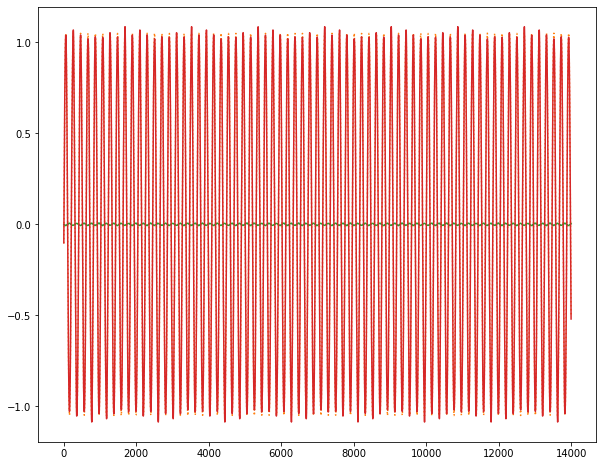

  1%|          | 16/1562 [00:00<00:09, 157.93it/s]

Epoch 3


100%|██████████| 1562/1562 [00:09<00:00, 158.97it/s]


Epoch 3 , mean error: 0.00039750047 params: [DeviceArray([[10479.609  ,  -447.66223],
             [  455.7693 ,  6437.604  ]], dtype=float32), DeviceArray([[65.343704  ,  0.39124602],
             [-0.30383867, 60.32219   ]], dtype=float32)]


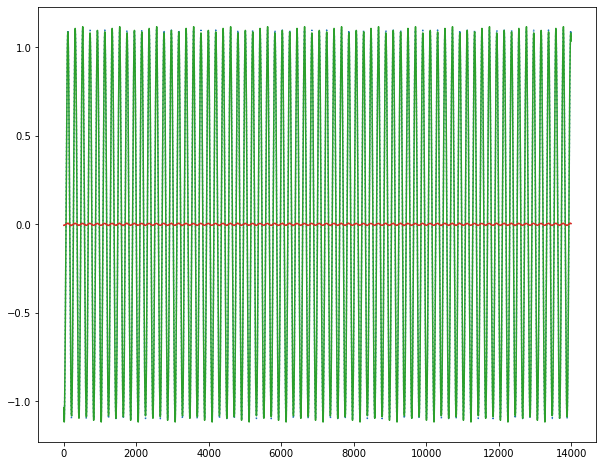

  0%|          | 1/1562 [00:00<03:34,  7.29it/s]

Epoch 0


100%|██████████| 1562/1562 [00:10<00:00, 155.12it/s]


Epoch 0 , mean error: 0.00056812813 params: [DeviceArray([[ 5.7519570e+03, -3.0134650e-02],
             [-2.0280762e-03,  5.8314204e+03]], dtype=float32), DeviceArray([[ 1.9476763e+01, -1.2233700e-03],
             [-6.0063343e-05,  1.3257172e+01]], dtype=float32)]


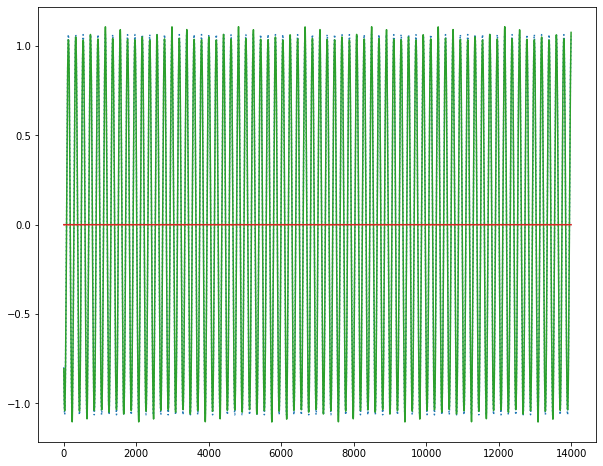

  1%|          | 13/1562 [00:00<00:12, 125.12it/s]

Epoch 1


100%|██████████| 1562/1562 [00:09<00:00, 157.71it/s]


Epoch 1 , mean error: 0.000391911 params: [DeviceArray([[ 5.7566304e+03, -3.8717154e-01],
             [-7.0057372e-03,  5.8380195e+03]], dtype=float32), DeviceArray([[1.9339371e+01, 9.2522241e-03],
             [7.2833456e-05, 1.3858456e+01]], dtype=float32)]


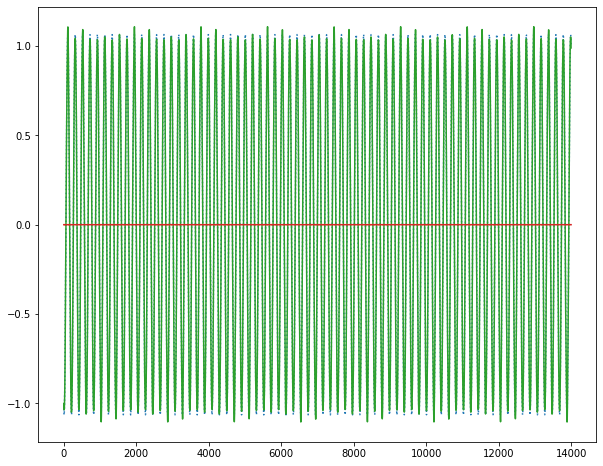

  1%|          | 12/1562 [00:00<00:13, 112.59it/s]

Epoch 2


100%|██████████| 1562/1562 [00:09<00:00, 157.44it/s]


Epoch 2 , mean error: 0.0003953718 params: [DeviceArray([[ 5.7575562e+03, -1.8126727e+00],
             [ 7.4188352e+00,  5.8391602e+03]], dtype=float32), DeviceArray([[19.351984  ,  0.02655208],
             [-0.39174742, 13.953454  ]], dtype=float32)]


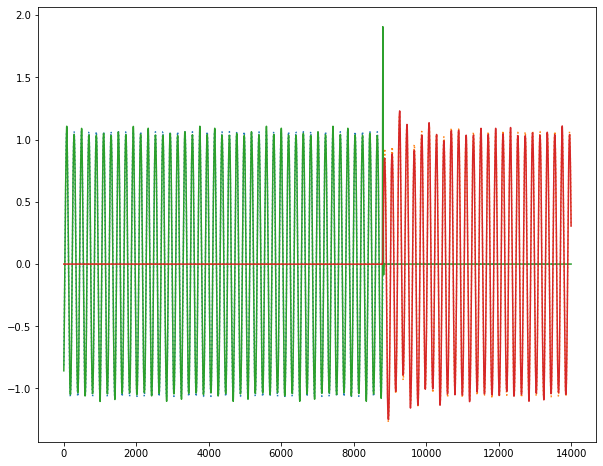

  1%|          | 18/1562 [00:00<00:08, 172.75it/s]

Epoch 3


100%|██████████| 1562/1562 [00:09<00:00, 163.08it/s]


Epoch 3 , mean error: 0.00039726312 params: [DeviceArray([[ 5.7576499e+03, -1.7823210e-01],
             [-9.4888330e-01,  5.8395283e+03]], dtype=float32), DeviceArray([[ 1.9352871e+01,  5.7069324e-03],
             [-3.1226450e-01,  1.3958166e+01]], dtype=float32)]


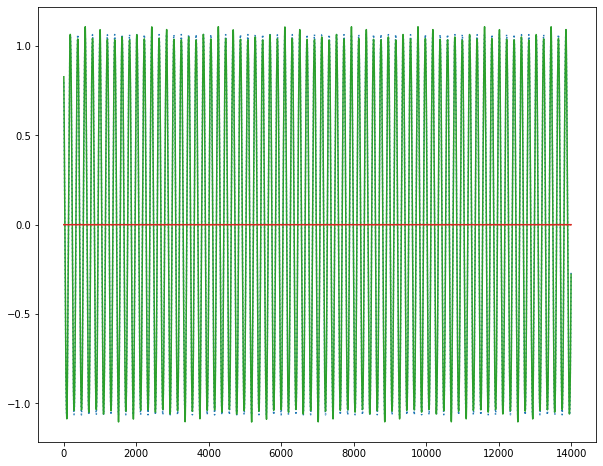

  0%|          | 1/1562 [00:00<03:25,  7.58it/s]

Epoch 0


100%|██████████| 1562/1562 [00:09<00:00, 159.13it/s]


Epoch 0 , mean error: 0.00061166316 params: [DeviceArray([[9683.354  , -503.38382],
             [ 455.38727, 5429.259  ]], dtype=float32), DeviceArray([[6.2624996e+01, 1.7863984e-01],
             [5.1078517e-02, 6.2305019e+01]], dtype=float32)]


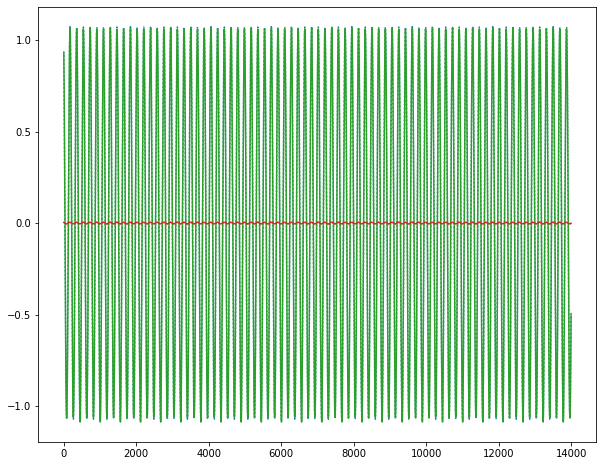

  1%|          | 17/1562 [00:00<00:09, 164.39it/s]

Epoch 1


100%|██████████| 1562/1562 [00:09<00:00, 162.50it/s]


Epoch 1 , mean error: 0.0004408474 params: [DeviceArray([[9657.486  , -498.88956],
             [ 455.11777, 5427.7324 ]], dtype=float32), DeviceArray([[63.162903  ,  0.63481784],
             [-0.11065812, 62.007282  ]], dtype=float32)]


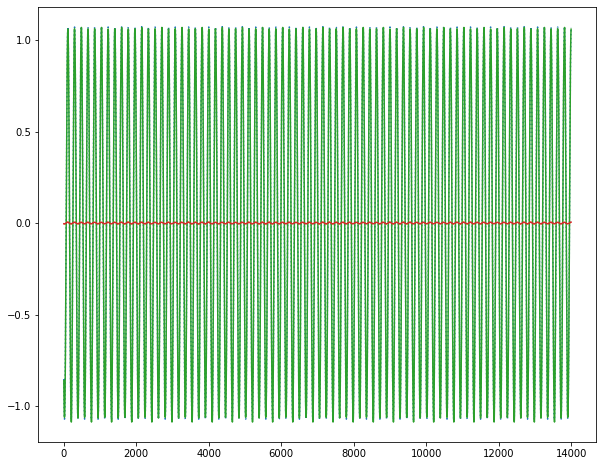

  1%|          | 18/1562 [00:00<00:08, 173.79it/s]

Epoch 2


100%|██████████| 1562/1562 [00:09<00:00, 159.94it/s]


Epoch 2 , mean error: 0.000443487 params: [DeviceArray([[9645.565  , -503.288  ],
             [ 453.42422, 5427.532  ]], dtype=float32), DeviceArray([[63.058483  ,  0.25590605],
             [-0.5662955 , 62.000458  ]], dtype=float32)]


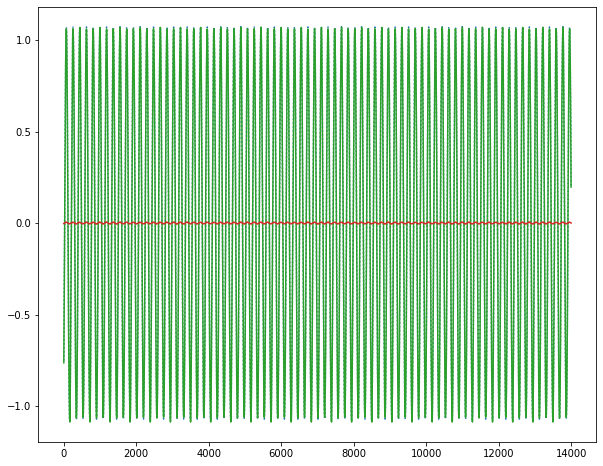

  1%|          | 18/1562 [00:00<00:08, 173.56it/s]

Epoch 3


100%|██████████| 1562/1562 [00:10<00:00, 151.98it/s]


Epoch 3 , mean error: 0.0004451394 params: [DeviceArray([[9642.83   , -496.55975],
             [ 493.58304, 5427.534  ]], dtype=float32), DeviceArray([[63.043613  ,  0.14022005],
             [ 0.4192692 , 62.006344  ]], dtype=float32)]


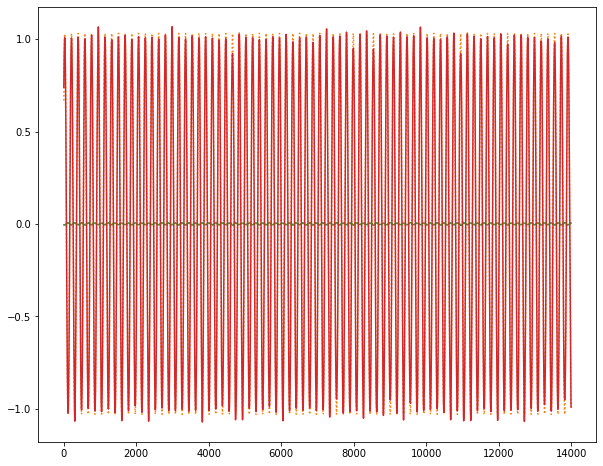

  0%|          | 1/1562 [00:00<03:33,  7.31it/s]

Epoch 0


100%|██████████| 1562/1562 [00:09<00:00, 157.08it/s]


Epoch 0 , mean error: 0.0009604897 params: [DeviceArray([[ 4.7650786e+03,  9.3388045e-01],
             [-6.5428376e-02,  4.8884282e+03]], dtype=float32), DeviceArray([[21.544096  , -0.07258711],
             [-0.06602664, 22.164204  ]], dtype=float32)]


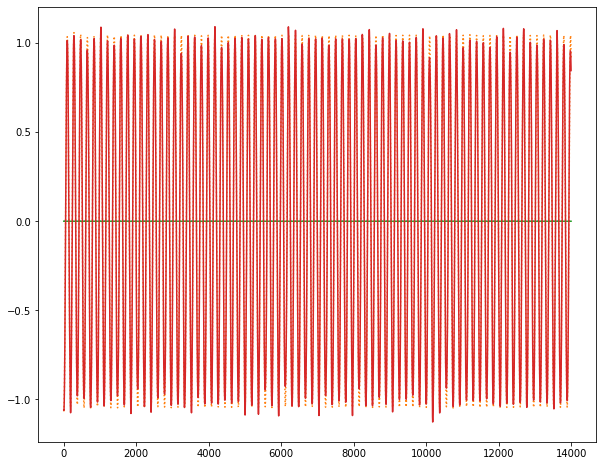

  1%|          | 16/1562 [00:00<00:10, 151.22it/s]

Epoch 1


100%|██████████| 1562/1562 [00:10<00:00, 148.93it/s]


Epoch 1 , mean error: 0.0007852915 params: [DeviceArray([[ 4.7756675e+03, -3.4076193e-01],
             [ 1.9499500e-01,  4.8880176e+03]], dtype=float32), DeviceArray([[19.96897   , -0.03663315],
             [-0.04922981, 21.84213   ]], dtype=float32)]


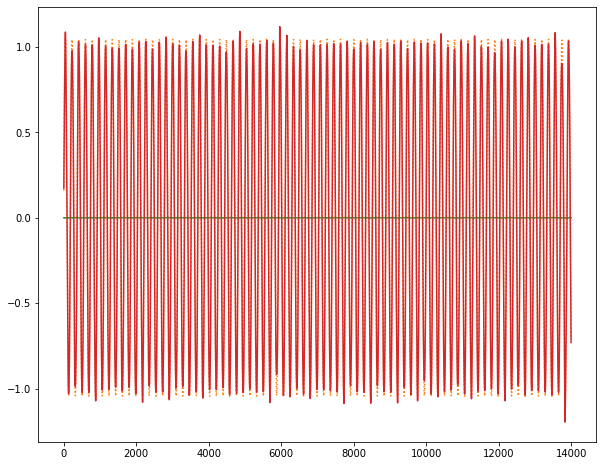

  1%|          | 13/1562 [00:00<00:13, 118.59it/s]

Epoch 2


100%|██████████| 1562/1562 [00:10<00:00, 152.15it/s]


Epoch 2 , mean error: 0.0007878616 params: [DeviceArray([[4.7772627e+03, 5.5990010e-01],
             [7.2262859e-01, 4.8877451e+03]], dtype=float32), DeviceArray([[19.903835  ,  0.38012546],
             [ 1.1428857 , 21.775223  ]], dtype=float32)]


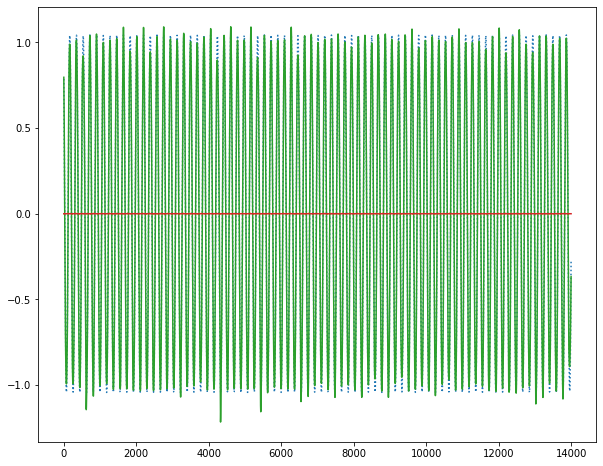

  1%|          | 15/1562 [00:00<00:10, 147.40it/s]

Epoch 3


100%|██████████| 1562/1562 [00:10<00:00, 153.00it/s]


Epoch 3 , mean error: 0.0007915349 params: [DeviceArray([[ 4.7774829e+03, -2.8386197e+00],
             [-5.4743032e+00,  4.8877617e+03]], dtype=float32), DeviceArray([[19.899717  ,  0.20490873],
             [-0.03667626, 21.771368  ]], dtype=float32)]


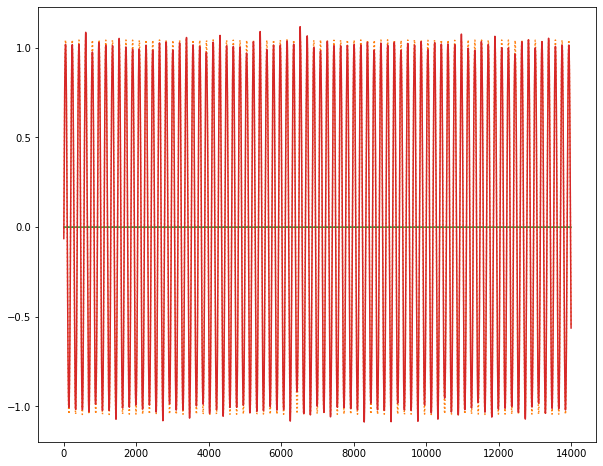

  0%|          | 1/1562 [00:00<03:23,  7.67it/s]

Epoch 0


100%|██████████| 1562/1562 [00:09<00:00, 158.33it/s]


Epoch 0 , mean error: 0.00057908235 params: [DeviceArray([[8574.298  , -483.05542],
             [ 471.23117, 4280.14   ]], dtype=float32), DeviceArray([[ 6.2184208e+01,  3.8691953e-02],
             [-8.1038728e-02,  6.3608585e+01]], dtype=float32)]


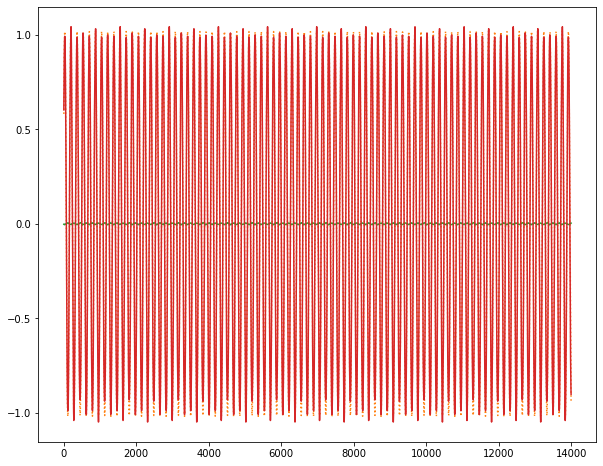

  1%|          | 16/1562 [00:00<00:09, 155.64it/s]

Epoch 1


100%|██████████| 1562/1562 [00:09<00:00, 160.38it/s]


Epoch 1 , mean error: 0.0004680406 params: [DeviceArray([[8576.741  , -476.60776],
             [ 471.33566, 4276.005  ]], dtype=float32), DeviceArray([[5.9935131e+01, 2.3391035e-01],
             [5.6517944e-02, 6.3578106e+01]], dtype=float32)]


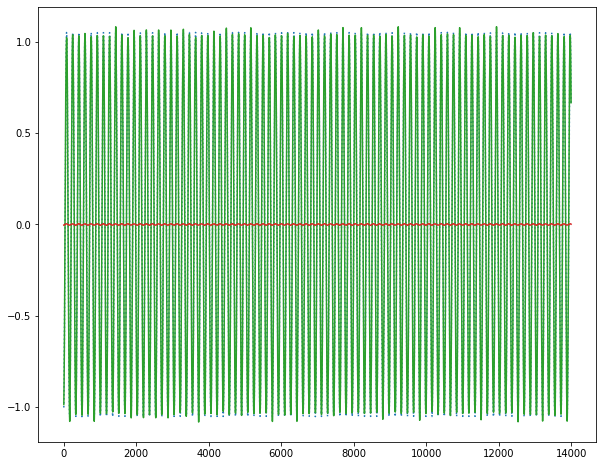

  1%|          | 18/1562 [00:00<00:08, 176.83it/s]

Epoch 2


100%|██████████| 1562/1562 [00:10<00:00, 155.40it/s]


Epoch 2 , mean error: 0.00046997576 params: [DeviceArray([[8574.688  , -464.9729 ],
             [ 470.53088, 4275.222  ]], dtype=float32), DeviceArray([[59.57487   , -0.53687847],
             [ 0.14945874, 63.576935  ]], dtype=float32)]


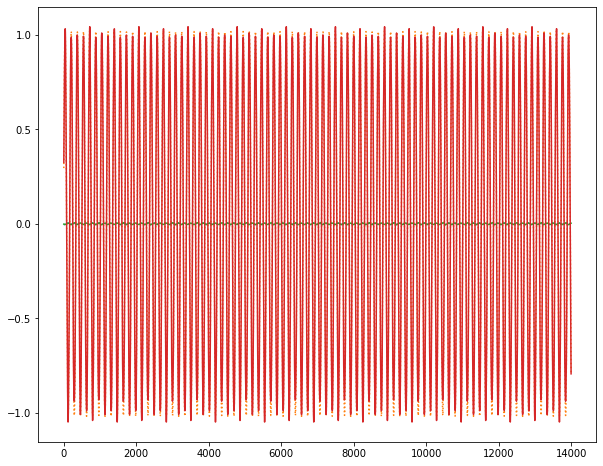

  1%|          | 18/1562 [00:00<00:09, 170.57it/s]

Epoch 3


100%|██████████| 1562/1562 [00:10<00:00, 153.94it/s]


Epoch 3 , mean error: 0.00047205834 params: [DeviceArray([[8574.229  , -470.12833],
             [ 471.41287, 4275.075  ]], dtype=float32), DeviceArray([[59.536392  ,  0.41604218],
             [-0.32988095, 63.575382  ]], dtype=float32)]


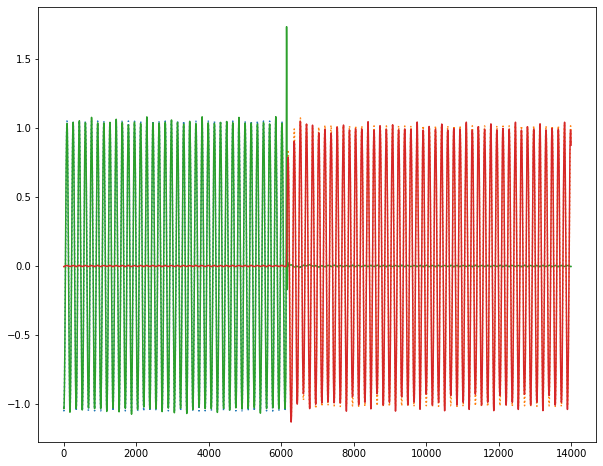

  0%|          | 1/1562 [00:00<03:41,  7.05it/s]

Epoch 0


100%|██████████| 1562/1562 [00:09<00:00, 159.43it/s]


Epoch 0 , mean error: 0.00084092474 params: [DeviceArray([[ 3.9985823e+03, -6.8190724e-01],
             [-6.8599294e-04,  3.9431506e+03]], dtype=float32), DeviceArray([[ 2.1426010e+01, -1.0910455e-02],
             [-1.2610487e-04,  1.8983305e+01]], dtype=float32)]


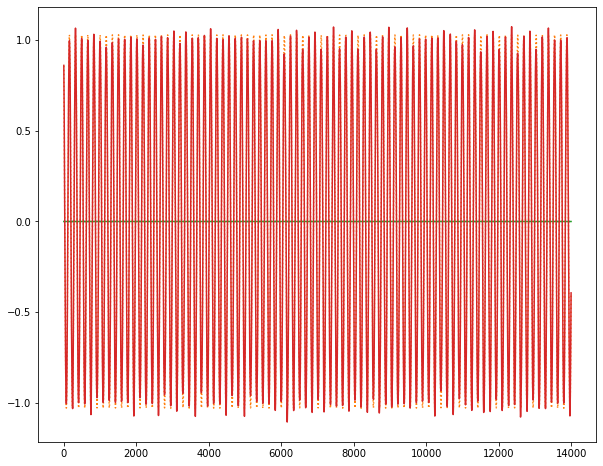

  1%|          | 17/1562 [00:00<00:09, 162.99it/s]

Epoch 1


100%|██████████| 1562/1562 [00:10<00:00, 155.34it/s]


Epoch 1 , mean error: 0.00073527143 params: [DeviceArray([[ 4.0068152e+03, -7.7737421e-01],
             [ 1.0044757e-01,  3.9452610e+03]], dtype=float32), DeviceArray([[ 2.1608236e+01,  2.7299821e-02],
             [-3.9395145e-03,  1.8962809e+01]], dtype=float32)]


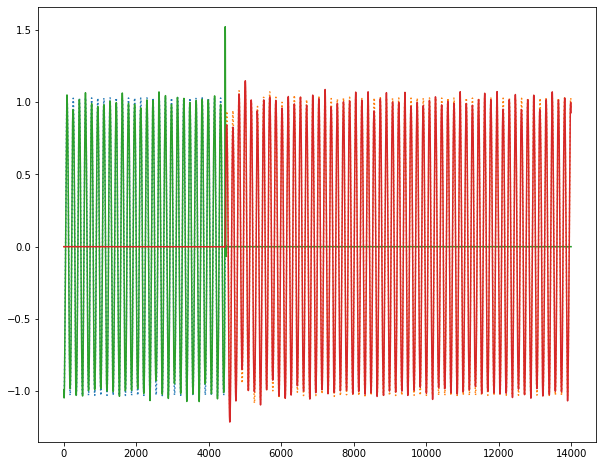

  1%|          | 17/1562 [00:00<00:09, 159.56it/s]

Epoch 2


100%|██████████| 1562/1562 [00:09<00:00, 158.30it/s]


Epoch 2 , mean error: 0.0007365269 params: [DeviceArray([[ 4.0081941e+03,  6.7242107e+00],
             [-6.6311449e-02,  3.9456462e+03]], dtype=float32), DeviceArray([[ 2.1620846e+01, -8.2092428e-01],
             [-2.9140878e-03,  1.8959578e+01]], dtype=float32)]


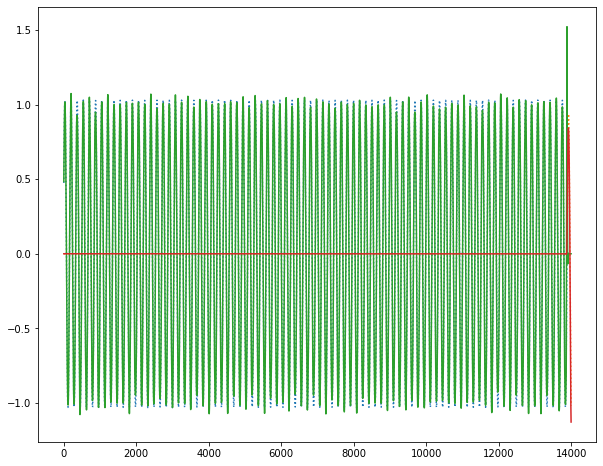

  1%|          | 16/1562 [00:00<00:09, 156.89it/s]

Epoch 3


100%|██████████| 1562/1562 [00:10<00:00, 146.61it/s]


Epoch 3 , mean error: 0.0007379676 params: [DeviceArray([[ 4.0084663e+03,  2.6373357e-01],
             [-2.7725173e-02,  3.9457253e+03]], dtype=float32), DeviceArray([[2.1621859e+01, 2.2612326e-01],
             [4.8021344e-04, 1.8959034e+01]], dtype=float32)]


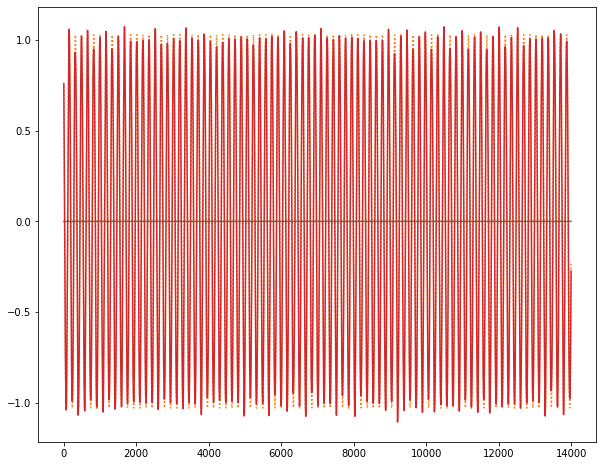

  0%|          | 1/1562 [00:00<04:46,  5.44it/s]

Epoch 0


100%|██████████| 1562/1562 [00:10<00:00, 148.80it/s]


Epoch 0 , mean error: 0.0008548542 params: [DeviceArray([[7231.2256 , -499.27975],
             [ 500.54807, 2697.891  ]], dtype=float32), DeviceArray([[ 6.6668076e+01,  7.2951227e-02],
             [-6.4852908e-02,  7.1608665e+01]], dtype=float32)]


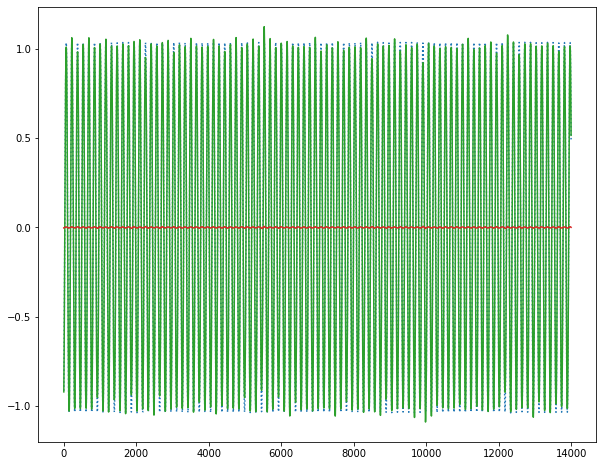

  1%|          | 15/1562 [00:00<00:10, 148.82it/s]

Epoch 1


100%|██████████| 1562/1562 [00:10<00:00, 152.42it/s]


Epoch 1 , mean error: 0.00075692864 params: [DeviceArray([[7245.355 , -503.5152],
             [ 511.7804, 2709.4153]], dtype=float32), DeviceArray([[65.8197    , -0.08438684],
             [-1.330653  , 71.18513   ]], dtype=float32)]


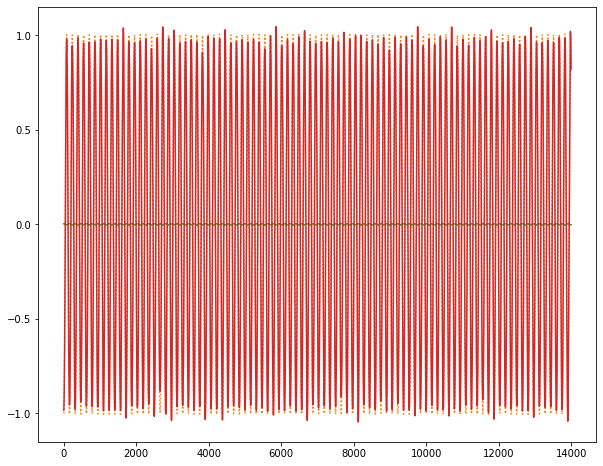

  1%|          | 17/1562 [00:00<00:09, 165.10it/s]

Epoch 2


100%|██████████| 1562/1562 [00:10<00:00, 155.87it/s]


Epoch 2 , mean error: 0.0007585322 params: [DeviceArray([[7246.1616 , -499.6362 ],
             [ 493.92737, 2711.3865 ]], dtype=float32), DeviceArray([[65.80409   ,  0.11396997],
             [-0.1015586 , 71.12316   ]], dtype=float32)]


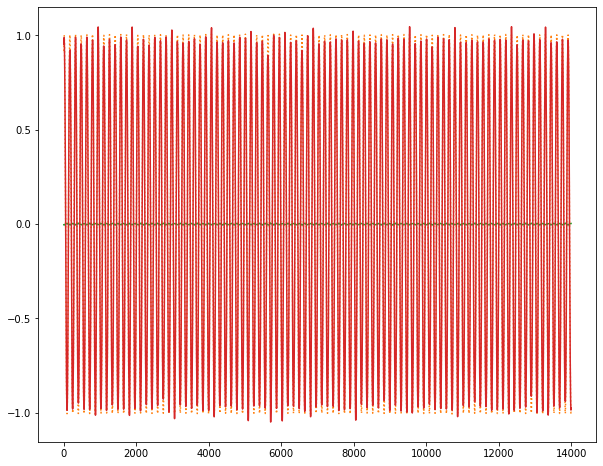

  1%|          | 17/1562 [00:00<00:09, 164.17it/s]

Epoch 3


100%|██████████| 1562/1562 [00:09<00:00, 159.40it/s]


Epoch 3 , mean error: 0.0007597221 params: [DeviceArray([[7246.2544 , -504.41245],
             [ 505.04425, 2711.8882 ]], dtype=float32), DeviceArray([[65.80362   , -0.46902037],
             [ 0.31390184, 71.11135   ]], dtype=float32)]


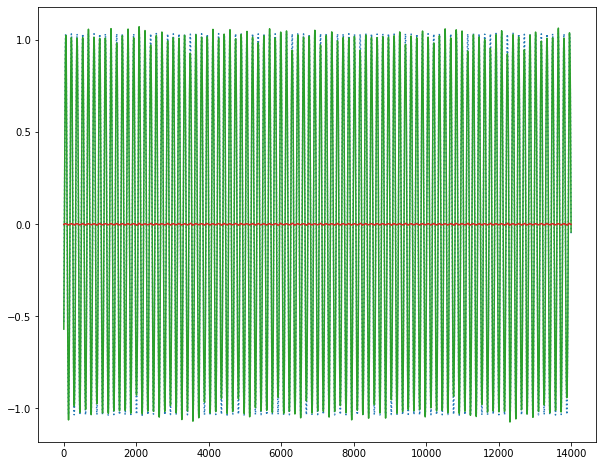

  0%|          | 1/1562 [00:00<03:23,  7.67it/s]

Epoch 0


100%|██████████| 1562/1562 [00:10<00:00, 151.70it/s]


Epoch 0 , mean error: 0.0007310544 params: [DeviceArray([[ 2.7859434e+03,  2.5007568e-02],
             [-6.5602112e-01,  2.7422937e+03]], dtype=float32), DeviceArray([[2.8102957e+01, 1.9026577e-02],
             [6.8235517e-02, 1.8570908e+01]], dtype=float32)]


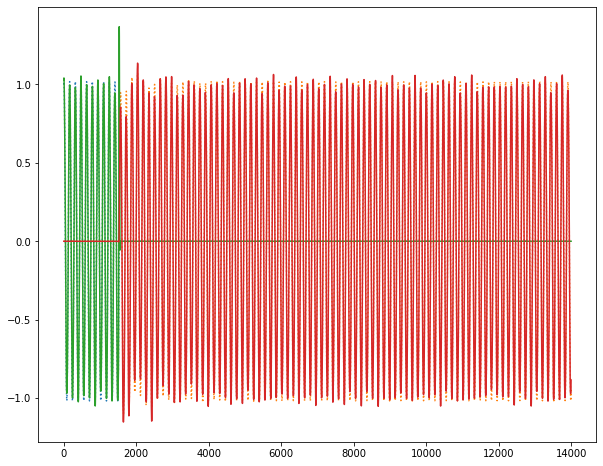

  1%|          | 18/1562 [00:00<00:08, 177.56it/s]

Epoch 1


100%|██████████| 1562/1562 [00:09<00:00, 166.89it/s]


Epoch 1 , mean error: 0.00062258984 params: [DeviceArray([[ 2.7876426e+03,  1.3236566e-01],
             [-8.6922801e-01,  2.7480332e+03]], dtype=float32), DeviceArray([[28.514832  , -0.12471649],
             [-0.46866685, 17.485285  ]], dtype=float32)]


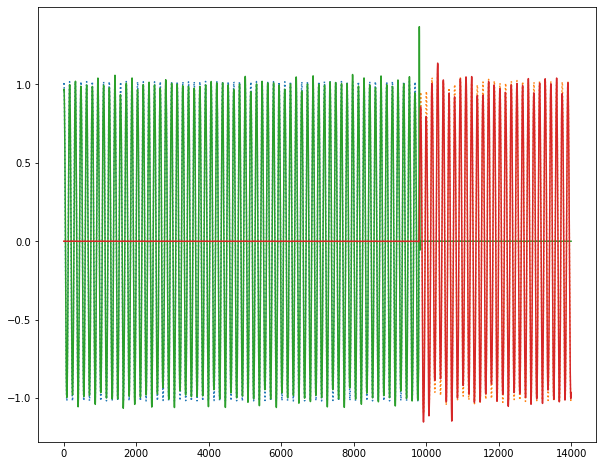

  1%|          | 18/1562 [00:00<00:08, 173.21it/s]

Epoch 2


100%|██████████| 1562/1562 [00:09<00:00, 163.81it/s]


Epoch 2 , mean error: 0.0006235272 params: [DeviceArray([[ 2.7880088e+03,  3.7313610e-02],
             [-2.0579851e+00,  2.7491841e+03]], dtype=float32), DeviceArray([[28.552547  , -0.07427959],
             [ 0.55166066, 17.416777  ]], dtype=float32)]


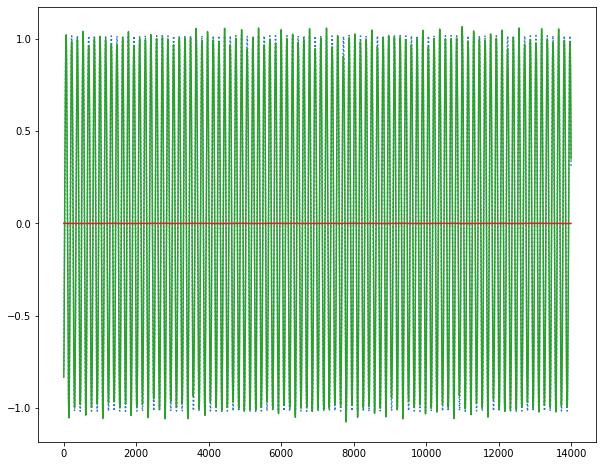

  1%|          | 16/1562 [00:00<00:10, 151.40it/s]

Epoch 3


100%|██████████| 1562/1562 [00:09<00:00, 166.84it/s]


Epoch 3 , mean error: 0.0006249931 params: [DeviceArray([[ 2.7880876e+03, -7.9727396e-02],
             [-1.3833382e+00,  2.7494414e+03]], dtype=float32), DeviceArray([[28.556126  , -0.08102515],
             [-0.3644136 , 17.409634  ]], dtype=float32)]


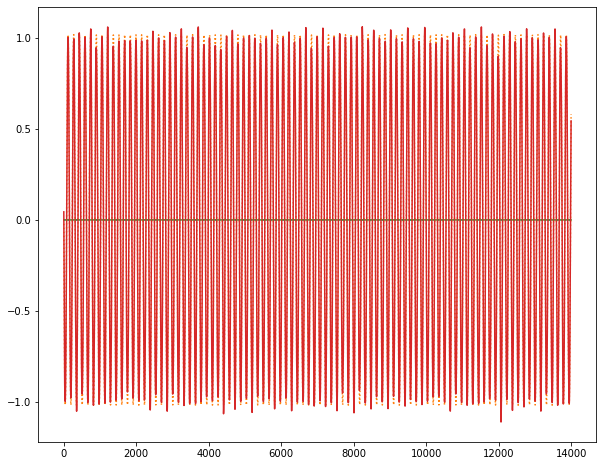

  0%|          | 1/1562 [00:00<03:35,  7.23it/s]

Epoch 0


100%|██████████| 1562/1562 [00:09<00:00, 163.99it/s]


Epoch 0 , mean error: 0.00056454155 params: [DeviceArray([[5477.4604 , -500.90887],
             [ 480.59695,  745.71765]], dtype=float32), DeviceArray([[55.637325  ,  0.23139168],
             [-0.28324315, 58.242043  ]], dtype=float32)]


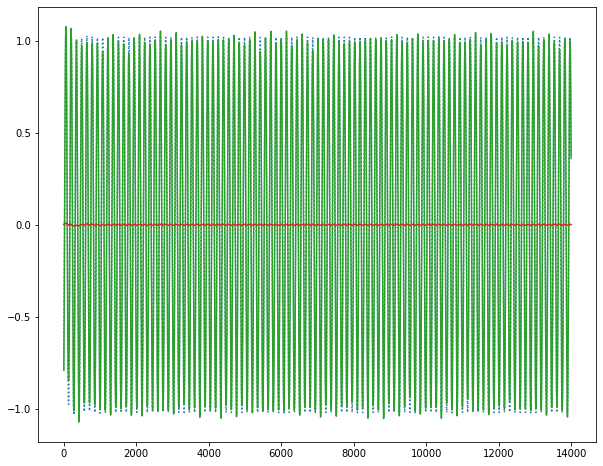

  1%|          | 16/1562 [00:00<00:09, 158.42it/s]

Epoch 1


100%|██████████| 1562/1562 [00:09<00:00, 159.96it/s]


Epoch 1 , mean error: 0.00049276254 params: [DeviceArray([[5474.3755, -495.2591],
             [ 475.3966,  742.4497]], dtype=float32), DeviceArray([[5.5636311e+01, 4.1449314e-01],
             [2.9617310e-02, 5.8313152e+01]], dtype=float32)]


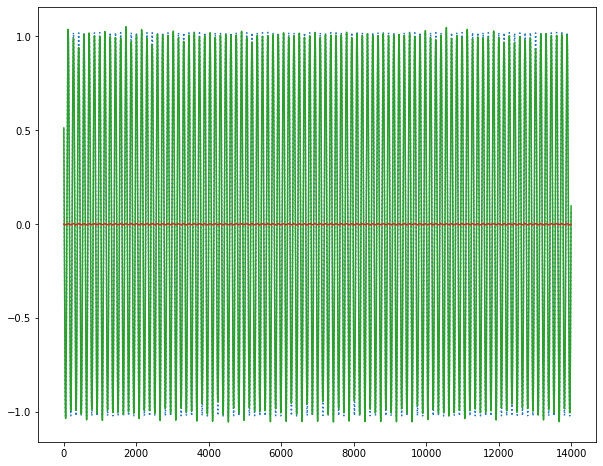

  1%|          | 17/1562 [00:00<00:09, 166.86it/s]

Epoch 2


100%|██████████| 1562/1562 [00:09<00:00, 162.70it/s]


Epoch 2 , mean error: 0.00049371505 params: [DeviceArray([[5473.769  , -511.2661 ],
             [ 477.708  ,  741.90576]], dtype=float32), DeviceArray([[55.637196  ,  0.20096079],
             [-0.4103273 , 58.316868  ]], dtype=float32)]


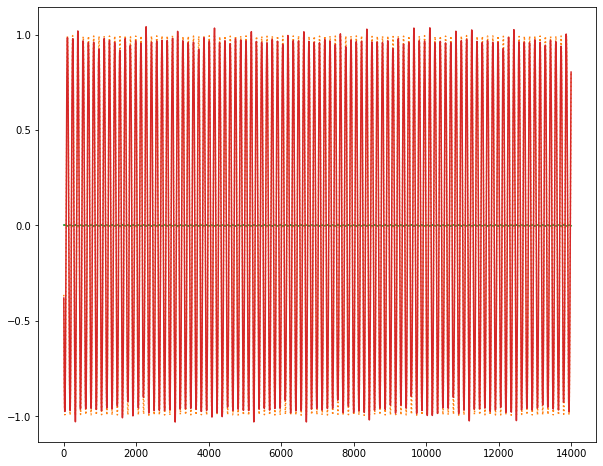

  1%|          | 15/1562 [00:00<00:10, 142.79it/s]

Epoch 3


100%|██████████| 1562/1562 [00:09<00:00, 162.01it/s]


Epoch 3 , mean error: 0.0004944848 params: [DeviceArray([[5473.3887 , -506.2747 ],
             [ 477.17902,  741.83167]], dtype=float32), DeviceArray([[55.641544  ,  0.18657273],
             [-0.5327246 , 58.316887  ]], dtype=float32)]


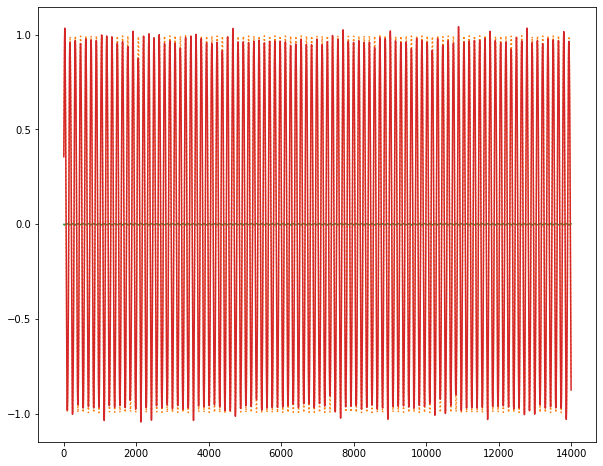

  0%|          | 1/1562 [00:00<04:08,  6.28it/s]

Epoch 0


100%|██████████| 1562/1562 [00:10<00:00, 150.24it/s]


Epoch 0 , mean error: 0.0007661706 params: [DeviceArray([[ 1.0975649e+03,  1.4975850e-01],
             [-4.4388664e-03,  1.5199724e+03]], dtype=float32), DeviceArray([[2.0587906e+01, 3.5379421e-02],
             [8.6382621e-05, 2.9967808e+01]], dtype=float32)]


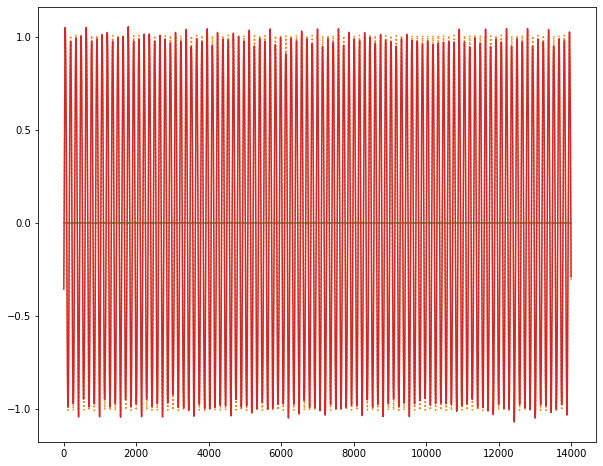

  1%|          | 16/1562 [00:00<00:10, 149.91it/s]

Epoch 1


100%|██████████| 1562/1562 [00:10<00:00, 152.89it/s]


Epoch 1 , mean error: 0.00067101244 params: [DeviceArray([[ 1.0964574e+03, -6.1159563e-01],
             [ 2.0332288e-02,  1.5243813e+03]], dtype=float32), DeviceArray([[ 2.0553452e+01, -2.9574156e-01],
             [-1.0084885e-04,  3.0286335e+01]], dtype=float32)]


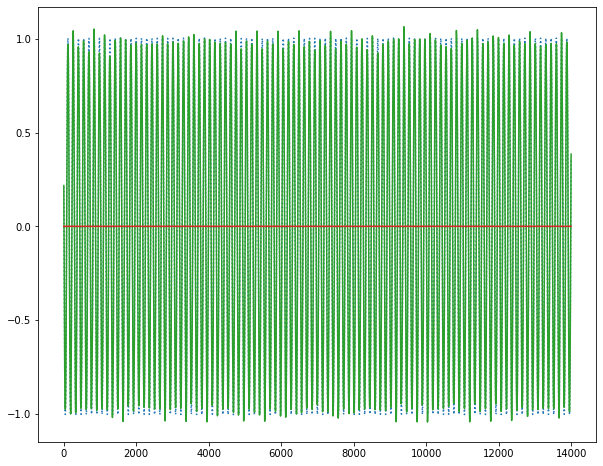

  1%|          | 16/1562 [00:00<00:10, 153.34it/s]

Epoch 2


100%|██████████| 1562/1562 [00:09<00:00, 159.24it/s]


Epoch 2 , mean error: 0.0006716684 params: [DeviceArray([[ 1.0963060e+03, -3.1472955e+00],
             [ 4.7733791e-02,  1.5249352e+03]], dtype=float32), DeviceArray([[ 2.0552559e+01, -3.3675648e-02],
             [-4.4208784e-03,  3.0315475e+01]], dtype=float32)]


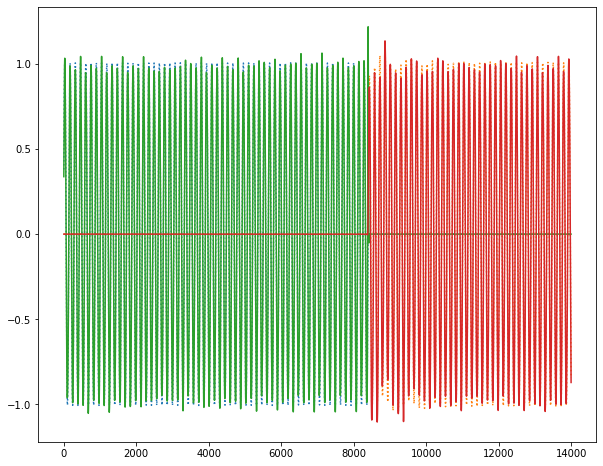

  1%|          | 18/1562 [00:00<00:08, 177.40it/s]

Epoch 3


100%|██████████| 1562/1562 [00:09<00:00, 161.14it/s]


Epoch 3 , mean error: 0.0006727263 params: [DeviceArray([[1.0962772e+03, 5.9668255e+00],
             [1.7584752e-02, 1.5250132e+03]], dtype=float32), DeviceArray([[ 2.0552578e+01, -2.9543310e-01],
             [-5.4785830e-04,  3.0318819e+01]], dtype=float32)]


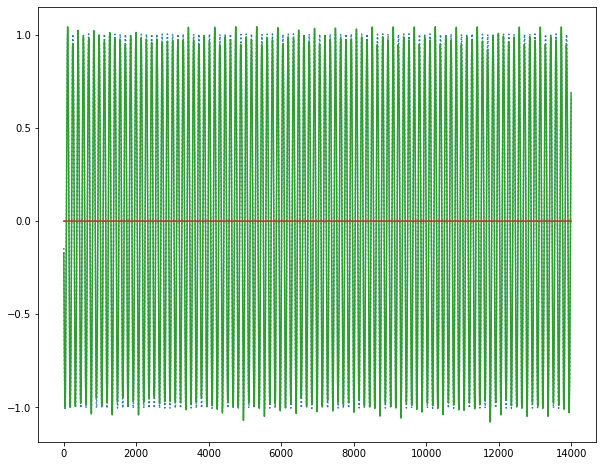

In [55]:
Cs = []
Ks = []
Fs = []

for freq in df_.freq.unique():
    
    sel_df = df_[(df_.seal == True) &  (df_.freq == freq)]
    with_seal = optimization_estimate(sel_df)
    
    sel_df = df_[(df_.seal == False) &  (df_.freq == freq)]
    wo_seal = optimization_estimate(sel_df)

    C = with_seal["C"] - wo_seal["C"]
    K = with_seal["K"] - wo_seal["K"]
    
    Cs.append(C)
    Ks.append(K)
    Fs.append(freq)
    
Cs = np.array(Cs)
Ks = np.array(Ks)
Fs = np.array(Fs)

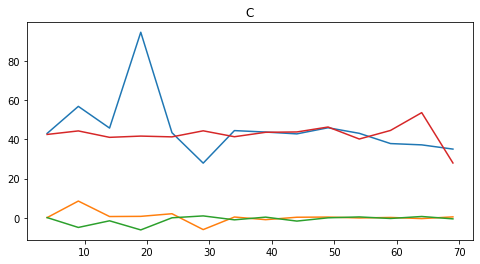

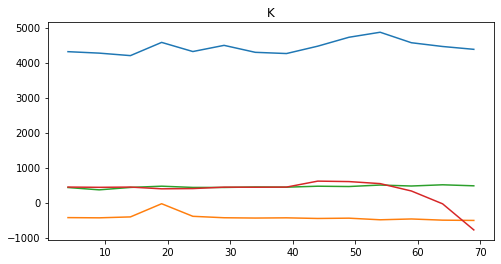

In [56]:
plt.figure(figsize=(8,4))
plt.title("C")
plt.plot(Fs, Cs[:, 0, 0])
plt.plot(Fs, Cs[:, 0, 1])
plt.plot(Fs, Cs[:, 1, 0])
plt.plot(Fs, Cs[:, 1, 1])
plt.show()


plt.figure(figsize=(8,4))
plt.title("K")
plt.plot(Fs, Ks[:, 0, 0])
plt.plot(Fs, Ks[:, 0, 1])
plt.plot(Fs, Ks[:, 1, 0])
plt.plot(Fs, Ks[:, 1, 1])
plt.show()